# EDA - Assesment # 1 - Telecom

In [145]:
## First, let's import the libraries
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import csv
import dataprep
from dataprep.eda import plot
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
from scipy.stats import pointbiserialr
import scipy.stats as ss





## Data Reading & General Overview - Variable Definition

In [146]:

# Load the dataset with semicolon as the delimiter
marketing = pd.read_csv('TeleCom_Data-1.csv', sep=';')

# Display the first few rows of the dataframe
marketing.head()

,"age;""job"";""marital"";""education"";""default"";""housing"";""loan"";""contact"";""month"";""day_of_week"";""duration"";""campaign"";""pdays"";""previous"";""poutcome"";""emp.var.rate"";""cons.price.idx"";""cons.conf.idx"";""euribor3m"";""nr.employed"";""y"""
0,"40;""admin."";""married"";""basic.6y"";""no"";""no"";""no..."
1,"56;""services"";""married"";""high.school"";""no"";""no..."
2,"45;""services"";""married"";""basic.9y"";""unknown"";""..."
3,"59;""admin."";""married"";""professional.course"";""n..."
4,"41;""blue-collar"";""married"";""unknown"";""unknown""..."


In [147]:
# lets find a different way to process the data reading because pd.read_csv is not working with the semicolon separator,
cleaned_data = []

with open('TeleCom_Data-1.csv', mode='r', encoding='utf-8') as file:
    reader = csv.reader(file, delimiter=';')
    for row in reader:
        cleaned_data.append(row)

# Manually split each row by semicolon and handle the quotes
split_data = [line[0].split(';') for line in cleaned_data]

# Convert the split data to a DataFrame
marketing = pd.DataFrame(split_data[1:], columns=split_data[0])

# Clean the column names and data by removing extra quotation marks
marketing.columns = [col.strip().replace('"', '').strip() for col in marketing.columns]
marketing = marketing.applymap(lambda x: x.strip().replace('"', '').strip())


original_data = marketing.copy()

# Display the first few rows of the cleaned DataFrame
marketing.head()



,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191,no
1,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191,no
2,45,services,married,basic.9y,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191,no
3,59,admin.,married,professional.course,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191,no
4,41,blue-collar,married,unknown,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191,no


In [148]:
marketing.shape

(41180, 21)

### Variable dictionary definitions

In [149]:
## I want to have here the dictionary of the columns and their data types
dict_market = pd.read_excel('Data_dictionary-1.xlsx')
dict_market

,Variable Name,Description
0,age,Age
1,job,Type of job
2,marital,Marital status
3,education,Level of education
4,default,Has credit in default
5,balance,Average yearly balance
6,housing,Has a housing loan
7,loan,Has a personal loan
8,contact,Contact communication type
9,day,Day of contact


In [150]:
marketing.shape

(41180, 21)

### Information of dataset variables

In [151]:
marketing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41180 entries, 0 to 41179
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             41180 non-null  object
 1   job             41180 non-null  object
 2   marital         41180 non-null  object
 3   education       41180 non-null  object
 4   default         41180 non-null  object
 5   housing         41180 non-null  object
 6   loan            41180 non-null  object
 7   contact         41180 non-null  object
 8   month           41180 non-null  object
 9   day_of_week     41180 non-null  object
 10  duration        41180 non-null  object
 11  campaign        41180 non-null  object
 12  pdays           41180 non-null  object
 13  previous        41180 non-null  object
 14  poutcome        41180 non-null  object
 15  emp.var.rate    41180 non-null  object
 16  cons.price.idx  41180 non-null  object
 17  cons.conf.idx   41180 non-null  object
 18  euribo

In [152]:

duplicate_rows = marketing.duplicated().sum()

# Display number of duplicate rows
print("\nNumber of duplicate rows:", duplicate_rows)



Number of duplicate rows: 12


However, these duplicates can be different entries because there is nothing that separates one client from another client. They can coincide in the same features

In [153]:
## assigning correct type

numeric_columns = ['age', 'duration', 'campaign', 'pdays', 'previous', 
                   'emp.var.rate', 'cons.price.idx', 'cons.conf.idx', 
                   'euribor3m', 'nr.employed']

marketing[numeric_columns] = marketing[numeric_columns].apply(pd.to_numeric, errors='coerce')

# Verify the changes
marketing.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41180 entries, 0 to 41179
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             41180 non-null  int64  
 1   job             41180 non-null  object 
 2   marital         41180 non-null  object 
 3   education       41180 non-null  object 
 4   default         41180 non-null  object 
 5   housing         41180 non-null  object 
 6   loan            41180 non-null  object 
 7   contact         41180 non-null  object 
 8   month           41180 non-null  object 
 9   day_of_week     41180 non-null  object 
 10  duration        41180 non-null  int64  
 11  campaign        41180 non-null  int64  
 12  pdays           41180 non-null  int64  
 13  previous        41180 non-null  int64  
 14  poutcome        41180 non-null  object 
 15  emp.var.rate    41180 non-null  float64
 16  cons.price.idx  41180 non-null  float64
 17  cons.conf.idx   41180 non-null 

### Summary Statistics 

In [154]:
## lets check the general description of the data using the describe methodology
marketing.describe()

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed
count,41180.000000,41180.000000,41180.000000,41180.000000,41180.000000,41180.000000,41180.000000,41180.000000,41180.000000,41180.000000
mean,40.021710,258.280427,2.567800,962.516707,0.172705,0.081901,93.575508,-40.501999,3.621422,5167.053344
std,10.419593,259.299856,2.770225,186.809028,0.493719,1.571037,0.578762,4.627358,1.734385,72.230334
min,17.000000,0.000000,1.000000,0.000000,0.000000,-3.400000,92.201000,-50.800000,0.634000,4963.600000
25%,32.000000,102.000000,1.000000,999.000000,0.000000,-1.800000,93.075000,-42.700000,1.344000,5099.100000
50%,38.000000,180.000000,2.000000,999.000000,0.000000,1.100000,93.749000,-41.800000,4.857000,5191.000000
75%,47.000000,319.000000,3.000000,999.000000,0.000000,1.400000,93.994000,-36.400000,4.961000,5228.100000
max,98.000000,4918.000000,56.000000,999.000000,7.000000,1.400000,94.767000,-26.900000,5.045000,5228.100000


In [155]:
## lets check the statistics for the categorical variables
marketing.describe(include='object')

,job,marital,education,default,housing,loan,contact,month,day_of_week,poutcome,y
count,41180,41180,41180,41180,41180,41180,41180,41180,41180,41180,41180
unique,12,4,8,3,3,3,2,10,5,3,2
top,admin.,married,university.degree,no,yes,no,cellular,may,thu,nonexistent,no
freq,10422,24921,12166,32581,21571,33943,26140,13765,8622,35559,36542


## Data Cleaning & Processing

In [156]:
# Check for missing values
missing_values = marketing.isnull().sum()

# Display columns with missing values
missing_values[missing_values > 0]


Series([], dtype: int64)

In [157]:
# Function to display unique values for a specific column
def inspect_column(column_name):
    print(f"Unique values in column '{column_name}':")
    print(marketing[column_name].unique())
    print("\n")

# Call this function for each column you're interested in inspecting
inspect_column('age')
inspect_column('job')
inspect_column('marital')
inspect_column('education')
inspect_column('default')
inspect_column('housing')
inspect_column('loan')


Unique values in column 'age':
[40 56 45 59 41 24 25 29 57 35 54 46 39 30 55 37 49 34 52 58 32 38 44 42
 60 53 50 47 51 48 33 31 43 36 28 27 26 22 23 20 21 61 19 18 70 66 76 67
 73 88 95 77 68 75 63 80 62 65 72 82 64 71 69 78 85 79 83 81 74 17 87 91
 86 98 94 84 92 89]


Unique values in column 'job':
['admin.' 'services' 'blue-collar' 'technician' 'housemaid' 'retired'
 'management' 'unemployed' 'self-employed' 'unknown' 'entrepreneur'
 'student']


Unique values in column 'marital':
['married' 'single' 'divorced' 'unknown']


Unique values in column 'education':
['basic.6y' 'high.school' 'basic.9y' 'professional.course' 'unknown'
 'basic.4y' 'university.degree' 'illiterate']


Unique values in column 'default':
['no' 'unknown' 'yes']


Unique values in column 'housing':
['no' 'yes' 'unknown']


Unique values in column 'loan':
['no' 'yes' 'unknown']




In [158]:

inspect_column('contact')
inspect_column('month')
inspect_column('day_of_week')
inspect_column('duration')
inspect_column('campaign')
inspect_column('pdays')

Unique values in column 'contact':
['telephone' 'cellular']


Unique values in column 'month':
['may' 'jun' 'jul' 'aug' 'oct' 'nov' 'dec' 'mar' 'apr' 'sep']


Unique values in column 'day_of_week':
['mon' 'tue' 'wed' 'thu' 'fri']


Unique values in column 'duration':
[ 151  307  198 ... 1246 1556 1868]


Unique values in column 'campaign':
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 19 18 23 14 22 25 16 17 15 20 56
 39 35 42 28 26 27 32 21 24 29 31 30 41 37 40 33 34 43]


Unique values in column 'pdays':
[999   6   4   3   5   1   0  10   7   8   9  11   2  12  13  14  15  16
  21  17  18  22  25  26  19  27  20]




In [159]:

inspect_column('previous')
inspect_column('poutcome')
inspect_column('emp.var.rate')
inspect_column('cons.price.idx')
inspect_column('cons.conf.idx')
inspect_column('euribor3m')
inspect_column('nr.employed')
inspect_column('y')


Unique values in column 'previous':
[0 1 2 3 4 5 6 7]


Unique values in column 'poutcome':
['nonexistent' 'failure' 'success']


Unique values in column 'emp.var.rate':
[ 1.1  1.4 -0.1 -0.2 -1.8 -2.9 -3.4 -3.  -1.7 -1.1]


Unique values in column 'cons.price.idx':
[93.994 94.465 93.918 93.444 93.798 93.2   92.756 92.843 93.075 92.893
 92.963 92.469 92.201 92.379 92.431 92.649 92.713 93.369 93.749 93.876
 94.055 94.215 94.027 94.199 94.601 94.767]


Unique values in column 'cons.conf.idx':
[-36.4 -41.8 -42.7 -36.1 -40.4 -42.  -45.9 -50.  -47.1 -46.2 -40.8 -33.6
 -31.4 -29.8 -26.9 -30.1 -33.  -34.8 -34.6 -40.  -39.8 -40.3 -38.3 -37.5
 -49.5 -50.8]


Unique values in column 'euribor3m':
[4.857 4.856 4.855 4.859 4.86  4.858 4.864 4.865 4.866 4.967 4.961 4.959
 4.958 4.96  4.962 4.955 4.947 4.956 4.966 4.963 4.957 4.968 4.97  4.965
 4.964 5.045 5.    4.936 4.921 4.918 4.912 4.827 4.794 4.76  4.733 4.7
 4.663 4.592 4.474 4.406 4.343 4.286 4.245 4.223 4.191 4.153 4.12  4.076
 4.021 3.901 3.8

  0%|          | 0/76 [00:00<?, ?it/s]


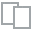
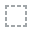
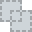
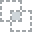
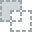
...
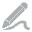
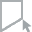
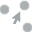
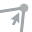
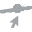

In [160]:
plot(marketing, 'y')

# EDA Analysis #

## Target Variable

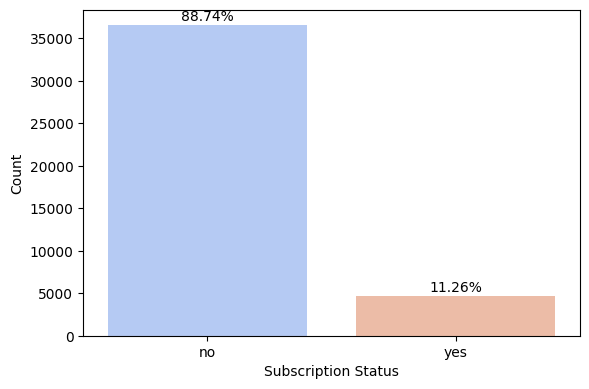

In [161]:
# Plot distribution of the target variable 'y' with percentages
plt.figure(figsize=(6, 4))
ax = sns.countplot(data=marketing, x='y', palette='coolwarm')

# Calculate percentages
total = len(marketing['y'])
for p in ax.patches:
    percentage = f'{100 * p.get_height() / total:.2f}%'
    ax.annotate(percentage, (p.get_x() + p.get_width() / 2, p.get_height()), 
                ha='center', va='center', xytext=(0, 6), textcoords='offset points')  # Adjusted offset

plt.xlabel('Subscription Status')
plt.ylabel('Count')

# Show plot
plt.tight_layout()
plt.show()

It is necessary to check variable by vvariable and analyze them individually and then what they relate with the y variable/

### Heatmap for the numerical values

In [162]:
corr_matrix = marketing.corr()

Text(0.5, 1.0, 'Correlation Matrix')

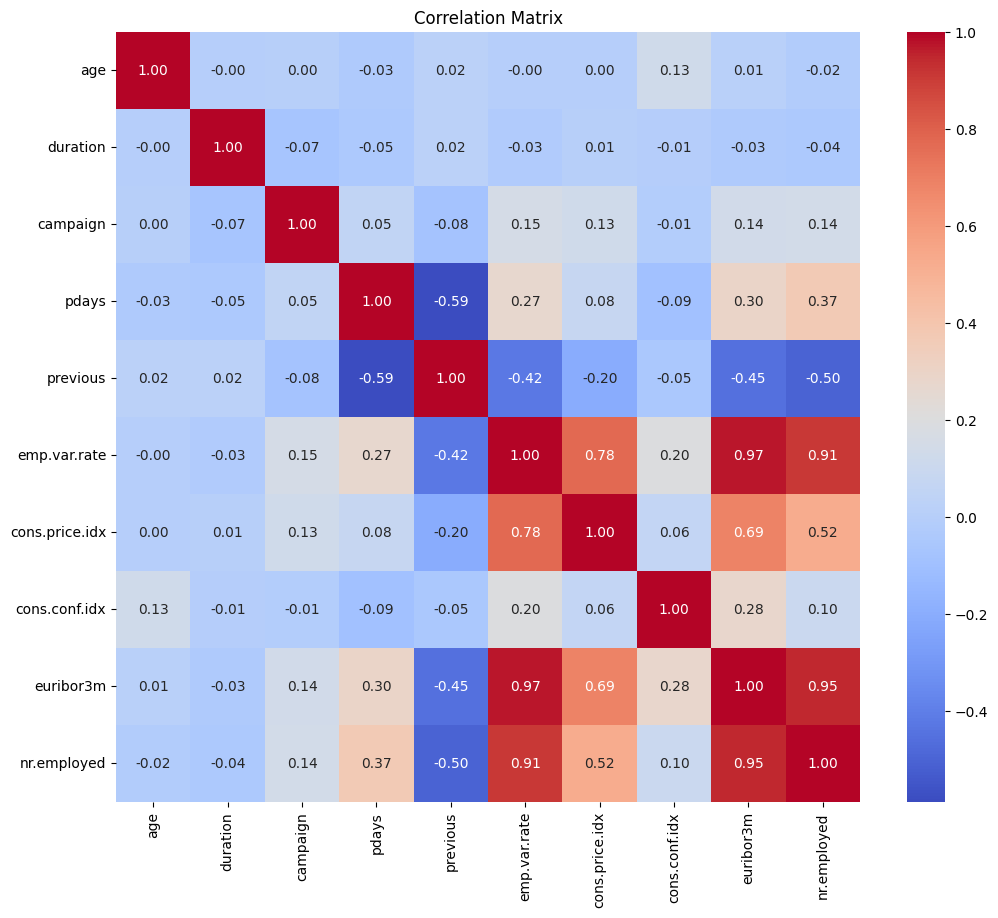

In [163]:
## generate a heatmap of the correlation matrix
plt.figure(figsize=(12, 10))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')

### Biserial correlation (Binary vs numerical values)

In [164]:

# Initialize LabelEncoder
label_encoder = LabelEncoder()

# Encode 'y' (target variable)
marketing['y'] = label_encoder.fit_transform(marketing['y'])

# Check the encoded values
print(marketing['y'].unique())  # Should output: [0, 1]


[0 1]


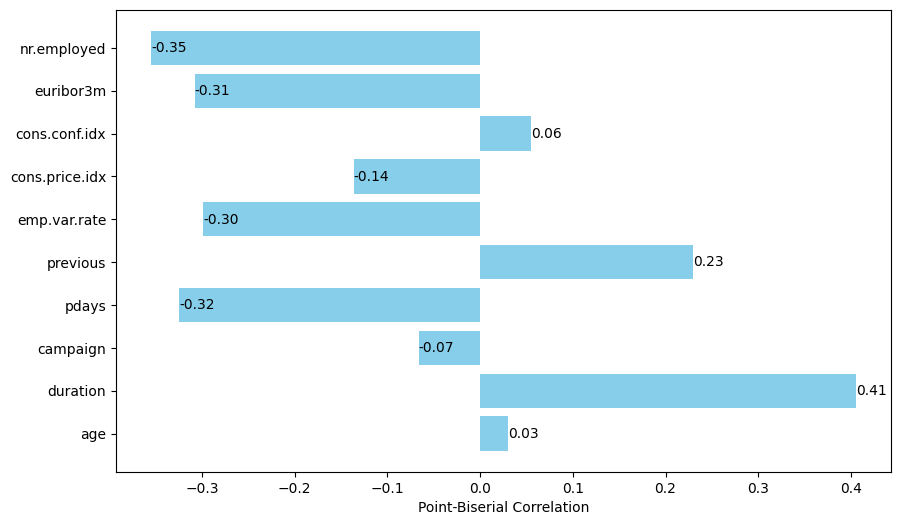

In [165]:

# Calculate Point-Biserial Correlation for each numerical column
correlations = {}
for col in numeric_columns:
    corr, _ = pointbiserialr(marketing[col], marketing['y'])
    correlations[col] = corr

# Create a DataFrame for easy plotting
correlation_df = pd.DataFrame(list(correlations.items()), columns=['Variable', 'Point-Biserial Correlation'])

# Plot the results with values on the bars
plt.figure(figsize=(10, 6))
ax = plt.barh(correlation_df['Variable'], correlation_df['Point-Biserial Correlation'], color='skyblue')

# Annotate the values on the bars
for index, value in enumerate(correlation_df['Point-Biserial Correlation']):
    plt.text(value, index, f'{value:.2f}', va='center', ha='left')

# Labels and title
plt.xlabel('Point-Biserial Correlation')
#plt.title('Point-Biserial Correlation Between Target Variable and Numerical Features')

# Show plot
plt.show()

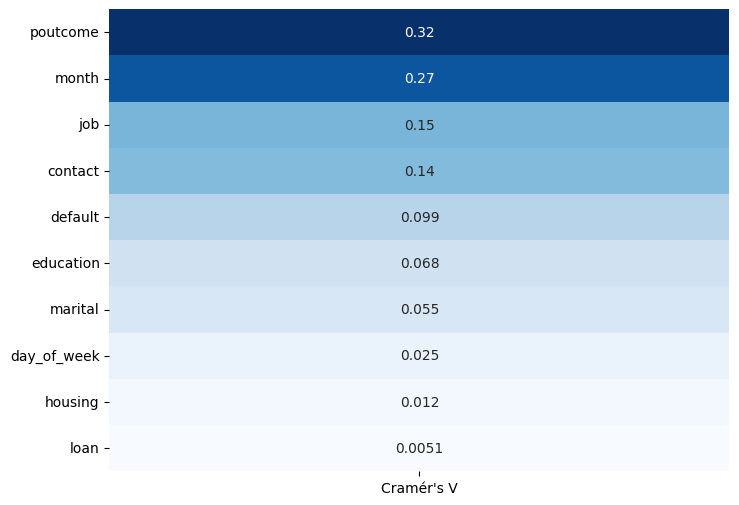

In [217]:


# Cramér's V calculation for categorical variables
def cramers_v(x, y):
    contingency_table = pd.crosstab(x, y)
    chi2 = ss.chi2_contingency(contingency_table)[0]
    n = contingency_table.sum().sum()
    r, k = contingency_table.shape
    return np.sqrt(chi2 / (n * (min(r - 1, k - 1))))

categorical_features = ['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact', 'month', 'day_of_week', 'poutcome']

# Calculate Cramér's V for each categorical feature
cramers_v_scores = {feature: cramers_v(marketing[feature], marketing['y']) for feature in categorical_features}

# Convert results into DataFrame and plot heatmap
cramers_v_df = pd.DataFrame.from_dict(cramers_v_scores, orient='index', columns=['Cramér\'s V']).sort_values(by='Cramér\'s V', ascending=False)

plt.figure(figsize=(8, 6))
sns.heatmap(cramers_v_df, annot=True, cmap='Blues', cbar=False)
#plt.title('Cramér\'s V Correlation between Categorical Features and Subscription Status')
plt.show()


### Age 

#### Univariate Analysis

  0%|          | 0/122 [00:00<?, ?it/s]


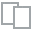
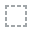
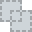
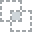
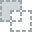
...
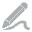
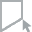
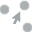
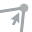
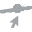

In [166]:
plot(marketing, 'age')

In [167]:
def analyze_column(df, column_name, chart_type='bar'):
    """
    Analyze and visualize a specific column in the DataFrame.

    Parameters:
    df (pd.DataFrame): The DataFrame containing the data.
    column_name (str): The name of the column to analyze.
    chart_type (str): The type of chart to display ('bar' or 'pie'). Default is 'bar'.
    """
    # Summary of the column
    print(f"Summary of '{column_name}':\n{df[column_name].describe()}\n")

    # Unique values in the column
    print(f"Unique values in '{column_name}':\n{df[column_name].unique()}\n")

    # Visualization of the column distribution
    plt.figure(figsize=(10, 5))
    
    if df[column_name].dtype in ['int64', 'float64']:
        sns.histplot(df[column_name], kde=True, bins=20)
        plt.title(f'Distribution of {column_name}')
    else:
        if chart_type == 'bar':
            sns.countplot(y=df[column_name], order=df[column_name].value_counts().index)
            plt.title(f'Distribution of {column_name} - Bar Chart')
        elif chart_type == 'pie':
            df[column_name].value_counts().plot.pie(autopct='%1.1f%%', startangle=90, figsize=(7, 7))
            plt.title(f'Distribution of {column_name} - Pie Chart')
            plt.ylabel('')  # Hide the y-label for pie charts
    
    plt.xlabel(column_name)
    plt.ylabel('Frequency')
    plt.show()



Summary of 'age':
count    41180.000000
mean        40.021710
std         10.419593
min         17.000000
25%         32.000000
50%         38.000000
75%         47.000000
max         98.000000
Name: age, dtype: float64

Unique values in 'age':
[40 56 45 59 41 24 25 29 57 35 54 46 39 30 55 37 49 34 52 58 32 38 44 42
 60 53 50 47 51 48 33 31 43 36 28 27 26 22 23 20 21 61 19 18 70 66 76 67
 73 88 95 77 68 75 63 80 62 65 72 82 64 71 69 78 85 79 83 81 74 17 87 91
 86 98 94 84 92 89]



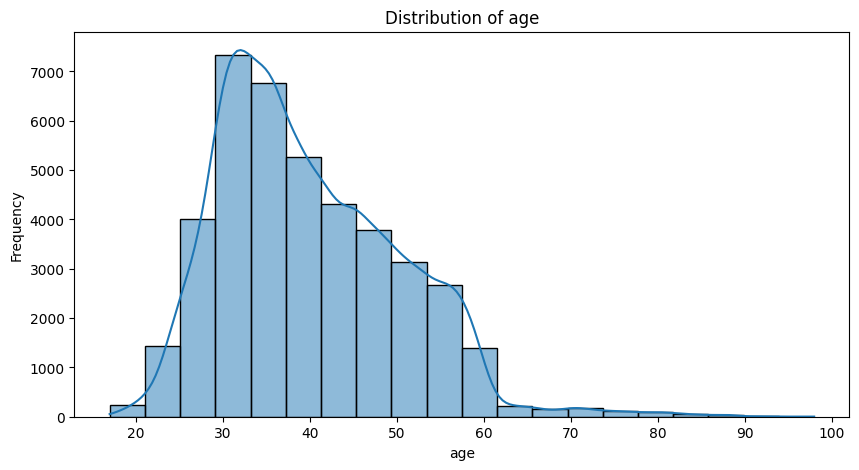

In [168]:
# Example usage with the 'age' column
analyze_column(marketing, 'age')

#### BIvariate Analysis

In [221]:
def bivariate_analysis(df, independent_var, target_var='y', chart_type='stacked_bar', exclude_unknown=True):
    """
    Perform bivariate analysis between an independent variable and the target variable,
    including multiple plots to visualize the relationship.

    Parameters:
    df (pd.DataFrame): The DataFrame containing the data.
    independent_var (str): The name of the independent variable to analyze.
    target_var (str): The name of the target variable (default is 'y').
    chart_type (str): The type of chart to display for categorical variables 
                      ('stacked_bar', 'bar', 'pie'). Default is 'stacked_bar'.
    exclude_unknown (bool): Whether to exclude 'unknown' categories. Default is True.
    """
    # Exclude 'unknown' values if required
    if exclude_unknown:
        df = df[df[independent_var] != 'unknown']

    print(f"Bivariate Analysis of '{independent_var}' and '{target_var}'\n")

    if df[independent_var].dtype in ['int64', 'float64']:
        # Numerical variable analysis

        # Boxplot
        plt.figure(figsize=(10, 5))
        sns.boxplot(x=target_var, y=independent_var, data=df)
        plt.title(f'{independent_var} vs. {target_var} - Boxplot')
        plt.xlabel(target_var)
        plt.ylabel(independent_var)
        plt.show()

        # Violin Plot
        plt.figure(figsize=(10, 5))
        sns.violinplot(x=target_var, y=independent_var, data=df)
        plt.title(f'{independent_var} vs. {target_var} - Violin Plot')
        plt.xlabel(target_var)
        plt.ylabel(independent_var)
        plt.show()

        # Histogram with KDE
        plt.figure(figsize=(10, 5))
        sns.histplot(df, x=independent_var, hue=target_var, kde=True, element='step')
        plt.title(f'{independent_var} vs. {target_var} - Histogram with KDE')
        plt.xlabel(independent_var)
        plt.ylabel('Density')
        plt.show()

        # Strip Plot
        plt.figure(figsize=(10, 5))
        sns.stripplot(x=target_var, y=independent_var, data=df, jitter=True)
        plt.title(f'{independent_var} vs. {target_var} - Strip Plot')
        plt.xlabel(target_var)
        plt.ylabel(independent_var)
        plt.show()

    else:
        # Categorical variable analysis

        if chart_type == 'stacked_bar':
            # Stacked Bar plot of proportions
            prop_df = (df.groupby([independent_var, target_var]).size() / 
                       df.groupby([independent_var]).size()).unstack()
            ax = prop_df.plot(kind='bar', stacked=True, figsize=(10, 5))
            plt.title(f'{independent_var} vs. {target_var} - Stacked Proportion Bar Plot')
            plt.xlabel(independent_var)
            plt.ylabel('Proportion')
            
            # Add annotations with percentages
            for container in ax.containers:
                # Multiply the values by 100 to display percentages
                labels = [f'{v * 100:.0f}%' if v > 0 else '' for v in container.datavalues]
                ax.bar_label(container, labels=labels, label_type='center', color='white')

            plt.show()

        elif chart_type == 'bar':
            # Countplot
            plt.figure(figsize=(10, 5))
            sns.countplot(x=independent_var, hue=target_var, data=df)
            plt.title(f'{independent_var} vs. {target_var} - Count Plot')
            plt.xlabel(independent_var)
            plt.ylabel('Count')
            plt.show()

        elif chart_type == 'pie':
            # Pie chart of proportions
            prop_df = df[target_var].groupby(df[independent_var]).value_counts(normalize=True).unstack()
            for idx, row in prop_df.iterrows():
                plt.figure(figsize=(7, 7))
                row.plot(kind='pie', autopct='%1.1f%%', startangle=90)
                plt.title(f'{independent_var}: {idx}')
                plt.ylabel('')
                plt.show()


Bivariate Analysis of 'age' and 'y'



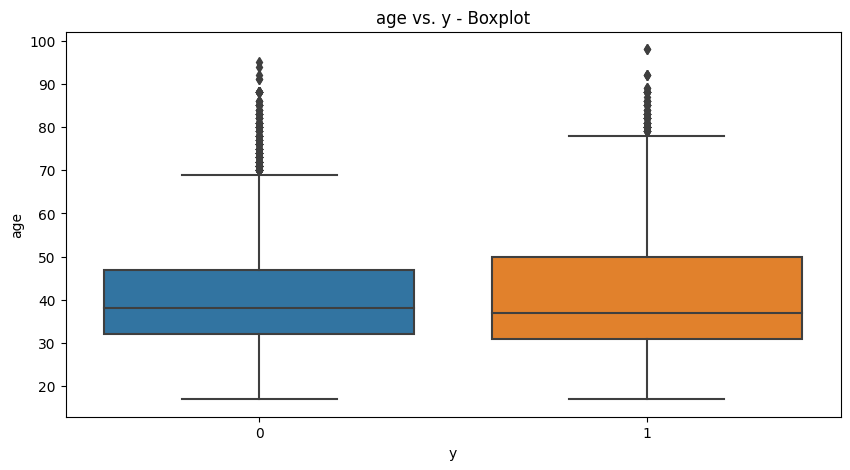

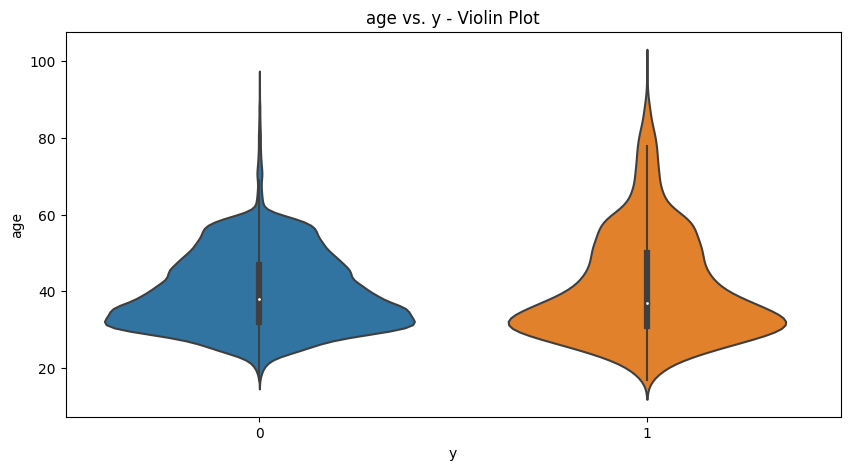

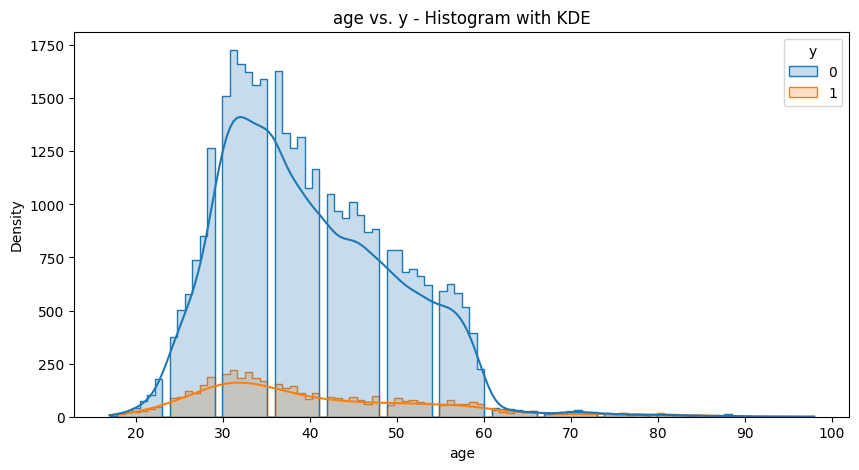

Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


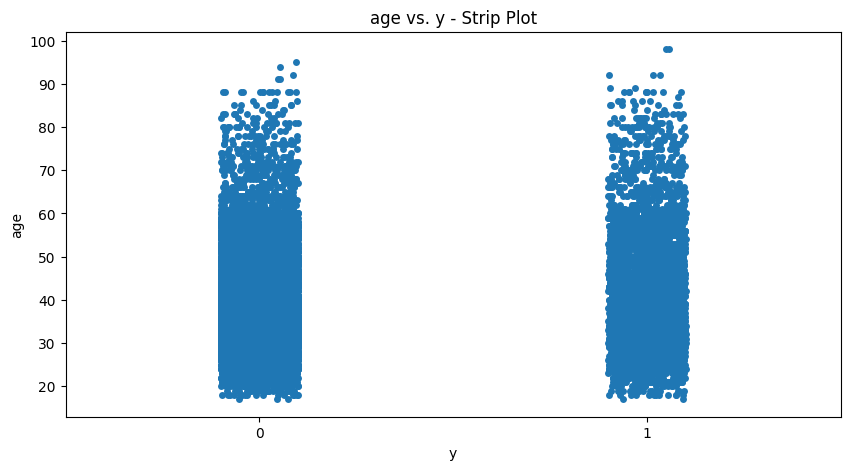

In [170]:
# Example usage with the 'age' column
bivariate_analysis(marketing, 'age')

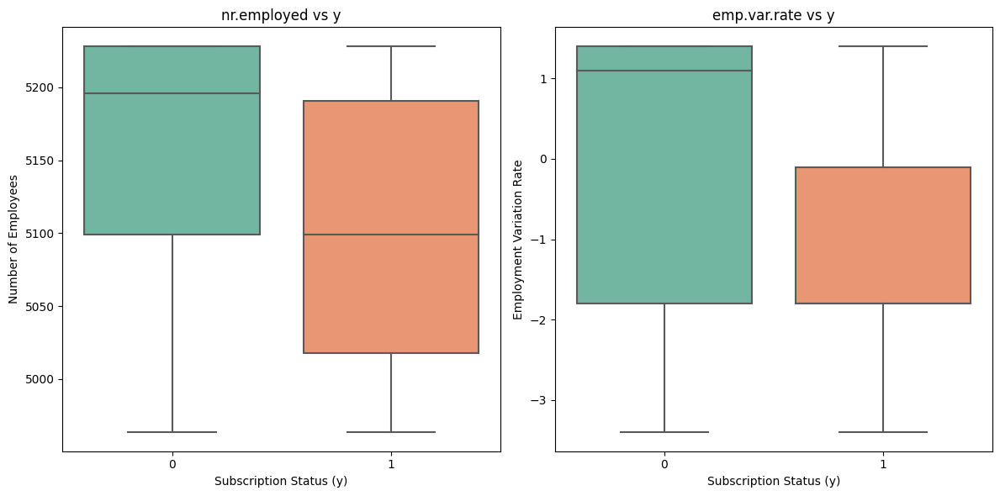

In [171]:
plt.figure(figsize=(12, 6))

# Subplot 1: nr.employed vs y
plt.subplot(1, 2, 1)
sns.boxplot(x='y', y='nr.employed', data=marketing, palette="Set2")
plt.title('nr.employed vs y')
plt.xlabel('Subscription Status (y)')
plt.ylabel('Number of Employees')

# Subplot 2: emp.var.rate vs y
plt.subplot(1, 2, 2)
sns.boxplot(x='y', y='emp.var.rate', data=marketing, palette="Set2")
plt.title('emp.var.rate vs y')
plt.xlabel('Subscription Status (y)')
plt.ylabel('Employment Variation Rate')

# Show the combined plots
plt.tight_layout()
plt.show()

Bivariate Analysis of 'euribor3m' and 'y'



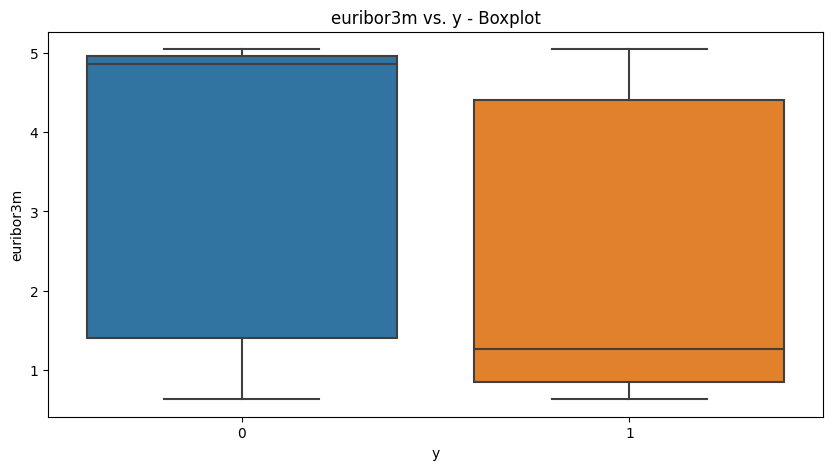

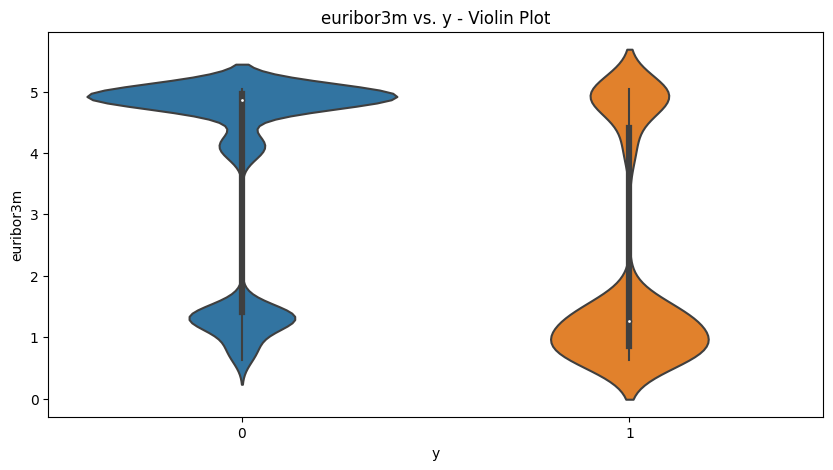

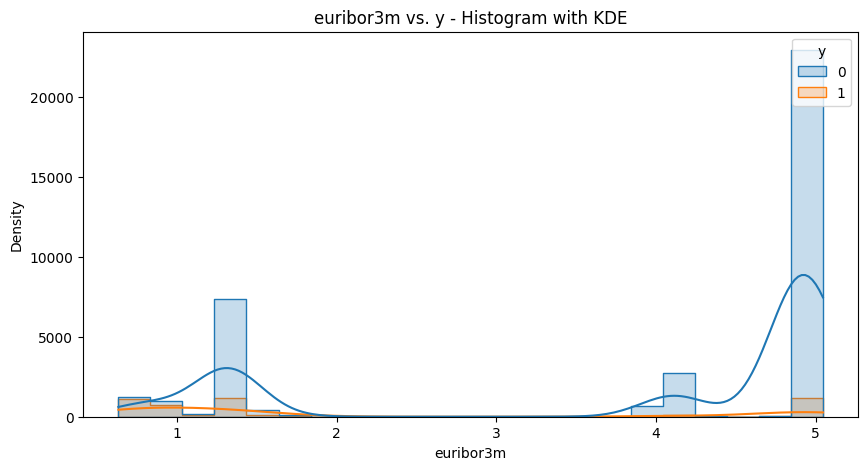

Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


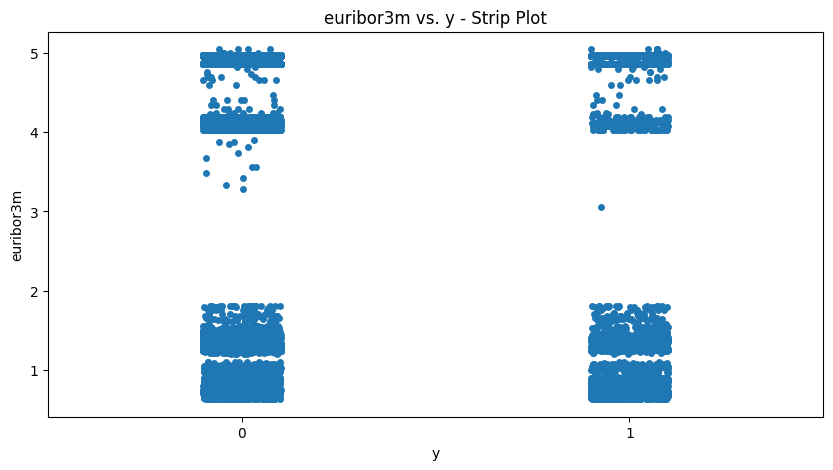

In [172]:
## lets plot euoribor3m vs 
bivariate_analysis(marketing, 'euribor3m')

Summary of 'nr.employed':
count    41180.000000
mean      5167.053344
std         72.230334
min       4963.600000
25%       5099.100000
50%       5191.000000
75%       5228.100000
max       5228.100000
Name: nr.employed, dtype: float64

Unique values in 'nr.employed':
[5191.  5228.1 5195.8 5176.3 5099.1 5076.2 5017.5 5023.5 5008.7 4991.6
 4963.6]



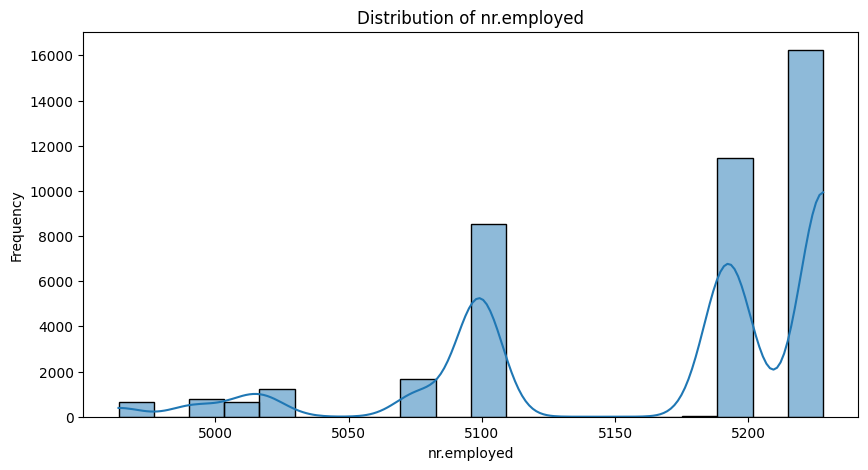

In [173]:
## lets analyze nr.employed
analyze_column(marketing, 'nr.employed')

Bivariate Analysis of 'nr.employed' and 'y'



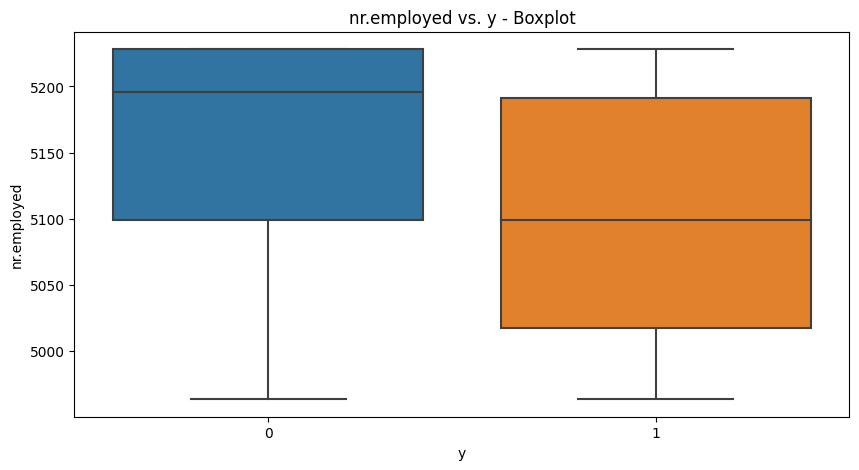

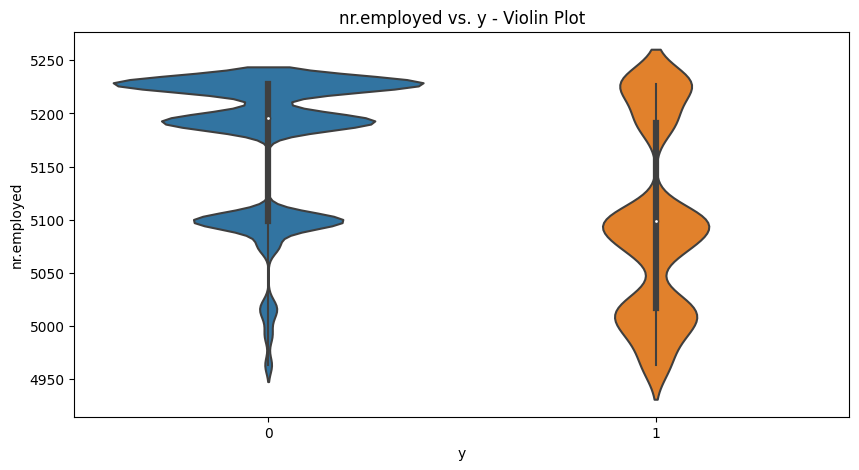

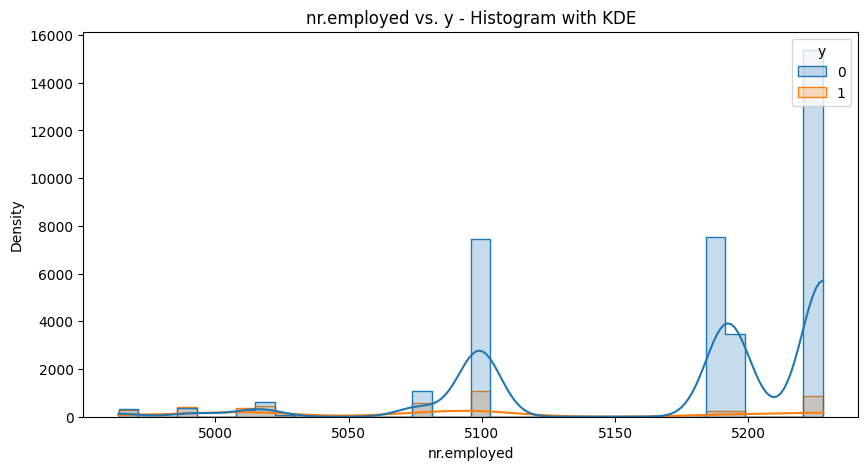

Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


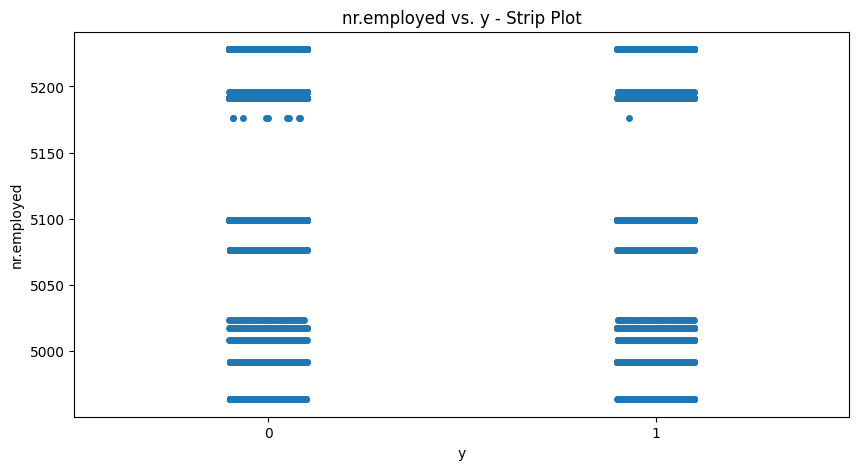

In [174]:
## bivariate for nr.employed
bivariate_analysis(marketing, 'nr.employed')

### JOB

#### Univariate

  0%|          | 0/76 [00:00<?, ?it/s]

/usr/local/lib/python3.10/site-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))



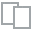
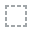
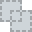
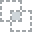
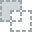
...
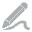
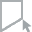
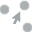
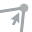
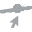

In [175]:
plot(marketing, 'job')

Summary of 'job':
count      41180
unique        12
top       admin.
freq       10422
Name: job, dtype: object

Unique values in 'job':
['admin.' 'services' 'blue-collar' 'technician' 'housemaid' 'retired'
 'management' 'unemployed' 'self-employed' 'unknown' 'entrepreneur'
 'student']



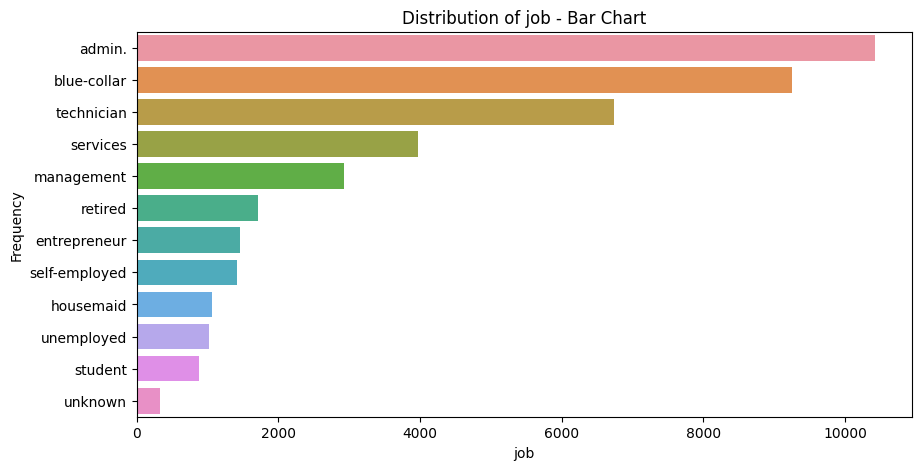

In [222]:
# Analyze the 'job' variable
analyze_column(marketing, 'job')


#### Bivariate

Bivariate Analysis of 'job' and 'y'



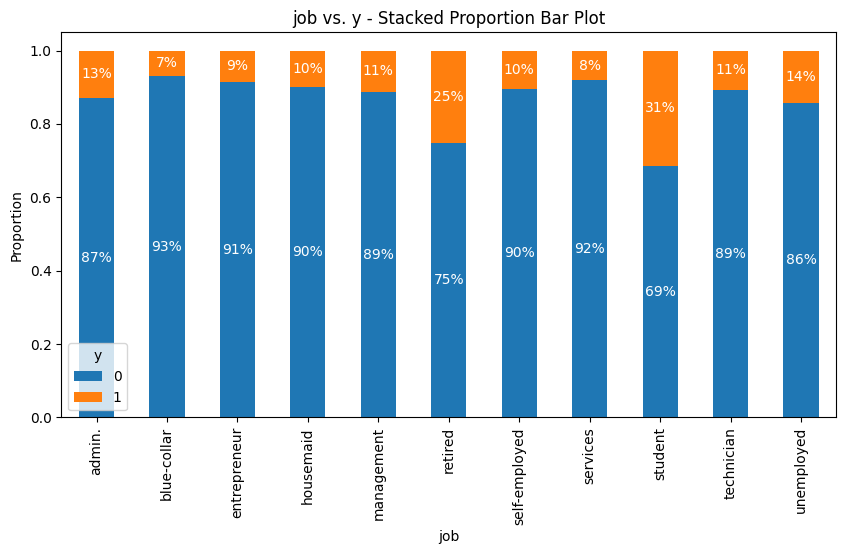

In [223]:
# Bivariate analysis of 'job' and 'y'
bivariate_analysis(marketing, 'job')


Bivariate Analysis of 'job' and 'y'



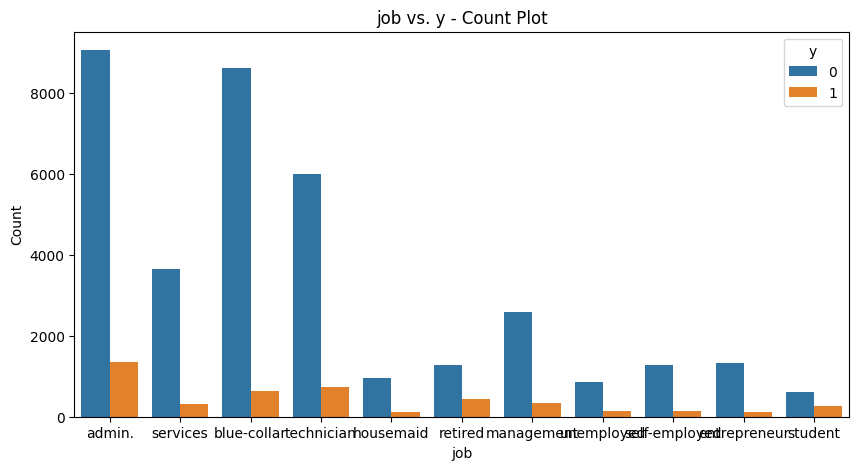

In [178]:
# Example usage with the 'job' column and a pie chart
bivariate_analysis(marketing, 'job', chart_type='bar')


In [179]:
def generate_summary_table(df, independent_var, target_var='y'):
    """
    Generate a summary table with counts and percentages of the target variable for each category 
    of the independent variable, sorted by the 'Yes_percent' in descending order.

    Parameters:
    df (pd.DataFrame): The DataFrame containing the data.
    independent_var (str): The name of the independent variable to analyze.
    target_var (str): The name of the target variable (default is 'y').

    Returns:
    pd.DataFrame: A DataFrame with counts and percentages for each category of the independent variable,
                  sorted by the 'Yes_percent'.
    """

    
    # Calculate counts
    count_df = df.groupby([independent_var, target_var]).size().unstack(fill_value=0)

    # Calculate percentages
    percentage_df = count_df.div(count_df.sum(axis=1), axis=0) * 100

    # Combine counts and percentages
    summary_df = count_df.join(percentage_df, lsuffix='_count', rsuffix='_percent')

    # Rename columns for clarity
    summary_df.columns = ['No_count', 'Yes_count', 'No_percent', 'Yes_percent']

    # Sort by 'Yes_percent' in descending order
    summary_df = summary_df.sort_values(by='Yes_percent', ascending=False)

    return summary_df



# Example usage with the 'job' column
job_summary = generate_summary_table(marketing, 'job')

# Display the summary table
job_summary


,No_count,Yes_count,No_percent,Yes_percent
job,,,,
student,600,275,68.571429,31.428571
retired,1285,433,74.796275,25.203725
unemployed,870,144,85.798817,14.201183
admin.,9070,1352,87.027442,12.972558
management,2595,328,88.778652,11.221348
unknown,293,37,88.787879,11.212121
technician,6013,729,89.187185,10.812815
self-employed,1272,149,89.514426,10.485574
housemaid,953,106,89.990557,10.009443


### Marital 

  0%|          | 0/76 [00:00<?, ?it/s]


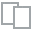
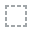
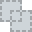
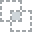
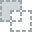
...
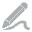
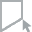
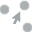
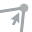
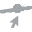

In [180]:
plot(marketing, 'marital')

Summary of 'marital':
count       41180
unique          4
top       married
freq        24921
Name: marital, dtype: object

Unique values in 'marital':
['married' 'single' 'divorced' 'unknown']



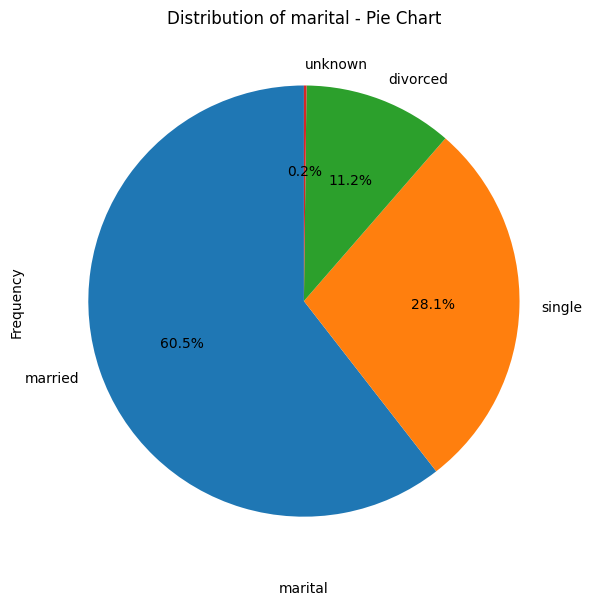

In [181]:

# Example usage with the 'marital' column and a pie chart
analyze_column(marketing, 'marital', chart_type='pie')

Bivariate Analysis of 'marital' and 'y'



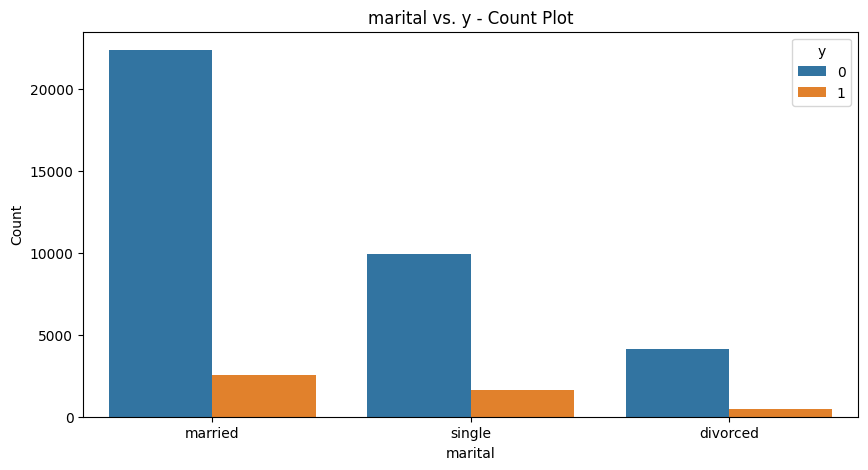

In [182]:
# Bivariate analysis of 'marital' and 'y'
bivariate_analysis(marketing, 'marital', chart_type='bar')


In [183]:
# Generate summary table for 'marital' and 'y'
marital_summary = generate_summary_table(marketing, 'marital')

# Display the summary table
marital_summary


,No_count,Yes_count,No_percent,Yes_percent
marital,,,,
unknown,68,12,85.000000,15.000000
single,9948,1620,85.995851,14.004149
divorced,4135,476,89.676860,10.323140
married,22391,2530,89.847919,10.152081


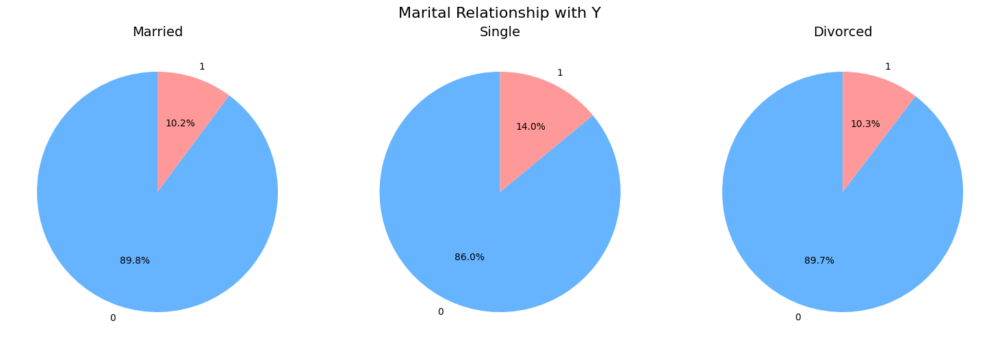

In [230]:
import matplotlib.pyplot as plt

def generate_pie_charts_per_category(df, column, target_var='y', exclude_unknown=True, colors=None):
    """
    Generate pie charts showing the relationship between each category of a given variable and the target variable.

    Parameters:
    df (pd.DataFrame): The DataFrame containing the data.
    column (str): The name of the column to generate pie charts for.
    target_var (str): The target variable, typically 'y'. Default is 'y'.
    exclude_unknown (bool): Whether to exclude 'unknown' categories from the charts. Default is True.
    colors (list of str): A list of colors to use for the pie chart. Default is None, which uses default colors.
    """
    # Filter out 'unknown' values if needed
    if exclude_unknown:
        df = df[df[column] != 'unknown']
    
    categories = df[column].unique()
    num_categories = len(categories)
    
    # Set default colors if none provided
    if colors is None:
        colors = ['#66b3ff', '#ff9999']  # Light blue for 0, light red for 1
    
    fig, axes = plt.subplots(1, num_categories, figsize=(5 * num_categories, 5), constrained_layout=True)
    fig.suptitle(f'{column.capitalize()} Relationship with {target_var.upper()}', fontsize=16)
    
    for i, category in enumerate(categories):
        category_data = df[df[column] == category][target_var]
        
        # Ensure that both 0 and 1 are present, even if one is missing from the data
        value_counts = category_data.value_counts()
        if 0 not in value_counts:
            value_counts[0] = 0
        if 1 not in value_counts:
            value_counts[1] = 0

        value_counts = value_counts.sort_index()  # Ensure consistent ordering
        
        value_counts.plot.pie(autopct='%1.1f%%', startangle=90, ax=axes[i], colors=colors)
        axes[i].set_title(f'{category.capitalize()}', fontsize=14)
        axes[i].set_ylabel('')  # Hide the y-label for pie charts
    
    plt.show()

# Now the colors for '0' and '1' will be consistent across all charts.
generate_pie_charts_per_category(marketing, 'marital', colors=['#66b3ff', '#ff9999'])


Not gigantic but single people are most common to say Yes.

### Education

  0%|          | 0/76 [00:00<?, ?it/s]


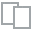
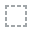
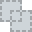
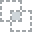
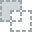
...
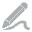
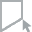
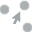
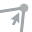
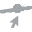

In [185]:
plot(marketing, 'education')

Summary of 'education':
count                 41180
unique                    8
top       university.degree
freq                  12166
Name: education, dtype: object

Unique values in 'education':
['basic.6y' 'high.school' 'basic.9y' 'professional.course' 'unknown'
 'basic.4y' 'university.degree' 'illiterate']



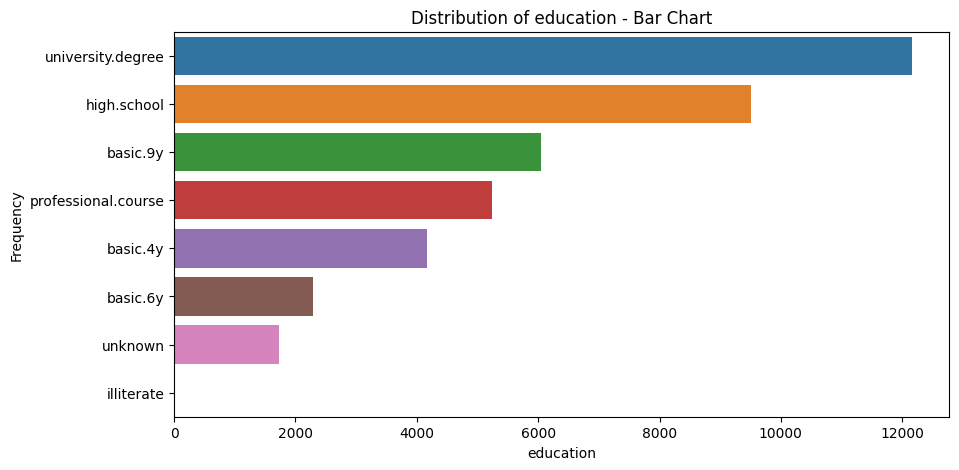

In [186]:
# Analyze the 'education' variable
analyze_column(marketing, 'education', chart_type='bar')


Bivariate Analysis of 'education' and 'y'



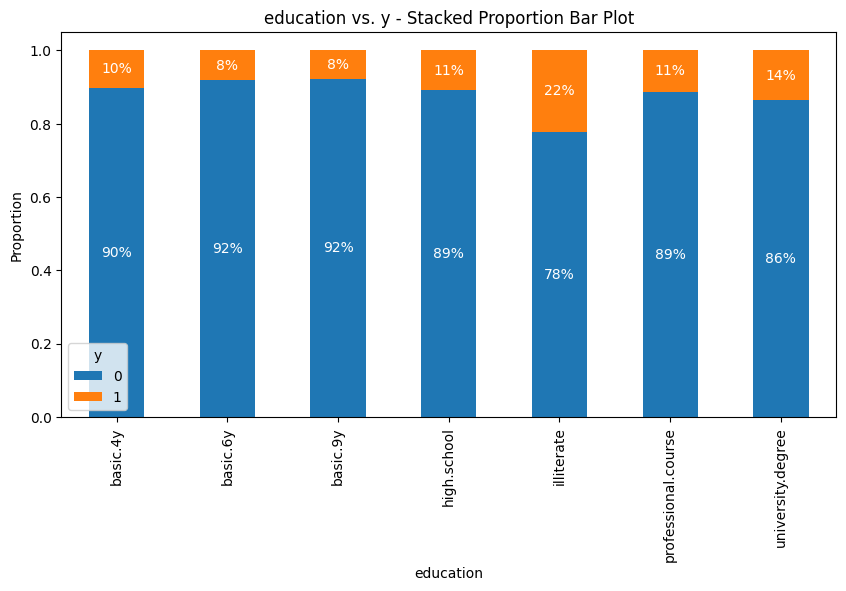

,No_count,Yes_count,No_percent,Yes_percent
education,,,,
illiterate,14,4,77.777778,22.222222
unknown,1480,251,85.499711,14.500289
university.degree,10497,1669,86.281440,13.718560
professional.course,4647,594,88.666285,11.333715
high.school,8482,1031,89.162199,10.837801
basic.4y,3747,428,89.748503,10.251497
basic.6y,2104,188,91.797557,8.202443
basic.9y,5571,473,92.174057,7.825943


In [224]:
# Bivariate analysis of 'education' and 'y'
bivariate_analysis(marketing, 'education', chart_type='stacked_bar')
# Generate summary table for 'education' and 'y'
education_summary = generate_summary_table(marketing, 'education')

# Display the summary table
education_summary


### Loan

Summary of 'housing':
count     41180
unique        3
top         yes
freq      21571
Name: housing, dtype: object

Unique values in 'housing':
['no' 'yes' 'unknown']



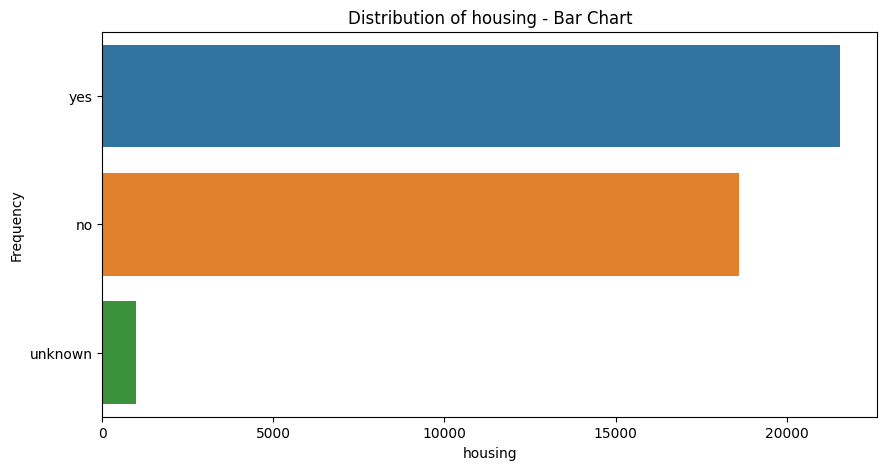

In [188]:
# Analyze the 'housing' variable
analyze_column(marketing, 'housing', chart_type='bar')


Bivariate Analysis of 'housing' and 'y'



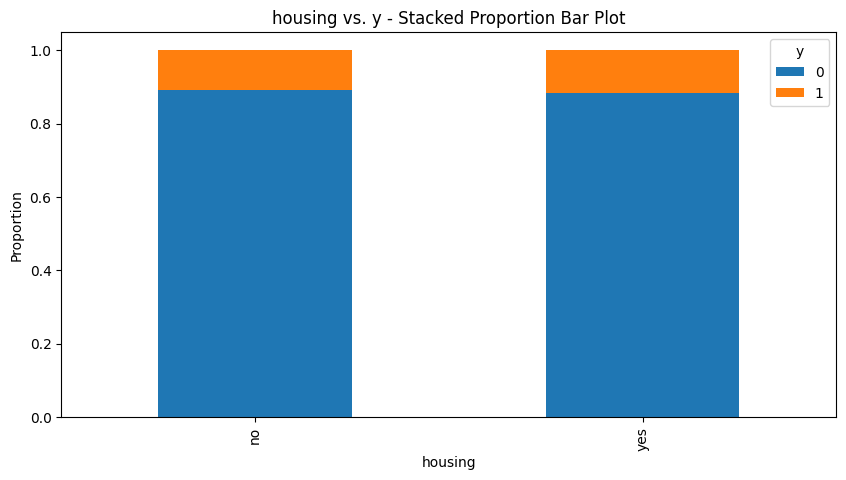

,No_count,Yes_count,No_percent,Yes_percent
housing,,,,
yes,19065,2506,88.382551,11.617449
no,16594,2025,89.124013,10.875987
unknown,883,107,89.191919,10.808081


In [189]:
# Bivariate analysis of 'housing' and 'y'
bivariate_analysis(marketing, 'housing', chart_type='stacked_bar')

# Generate summary table for 'housing' and 'y'
housing_summary = generate_summary_table(marketing, 'housing')

# Display the summary table
housing_summary

### Loan

Summary of 'loan':
count     41180
unique        3
top          no
freq      33943
Name: loan, dtype: object

Unique values in 'loan':
['no' 'yes' 'unknown']



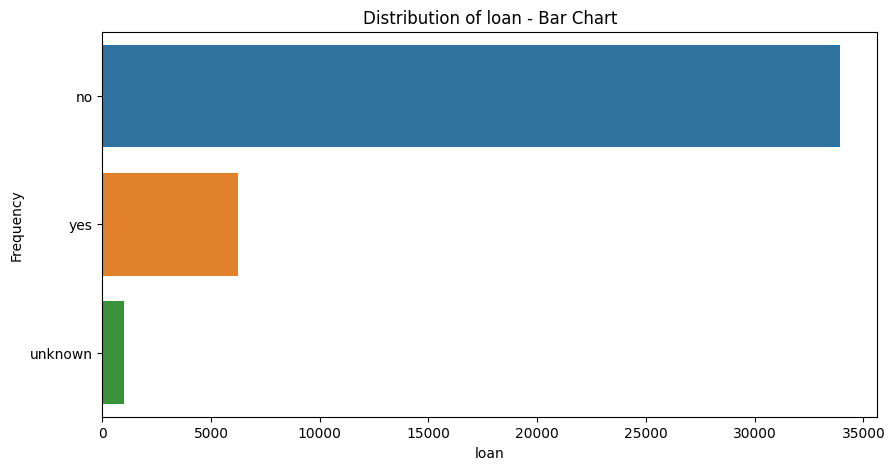

In [190]:
# Analyze the 'loan' variable
analyze_column(marketing, 'loan', chart_type='bar')


Bivariate Analysis of 'loan' and 'y'



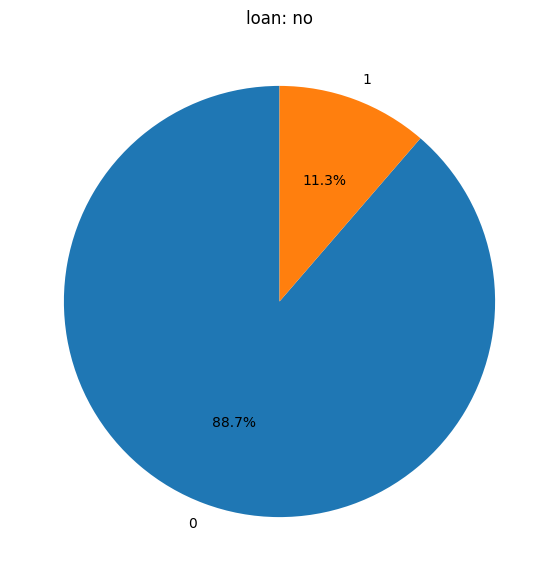

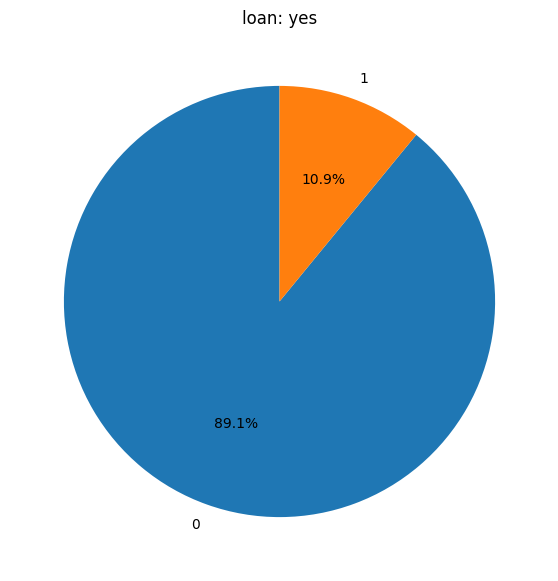

In [191]:
# Bivariate analysis of 'loan' and 'y'
bivariate_analysis(marketing, 'loan', chart_type='pie')


No influence in the main variable...

### Contact

  0%|          | 0/76 [00:00<?, ?it/s]


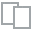
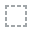
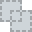
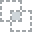
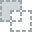
...
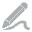
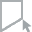
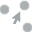
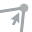
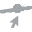

In [192]:
plot(marketing, 'contact')

Summary of 'contact':
count        41180
unique           2
top       cellular
freq         26140
Name: contact, dtype: object

Unique values in 'contact':
['telephone' 'cellular']



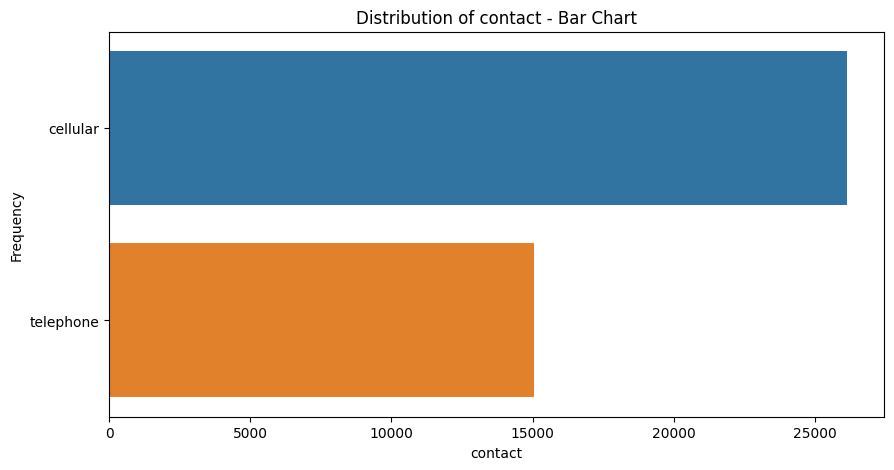

In [193]:
# Analyze the 'contact' variable
analyze_column(marketing, 'contact', chart_type='bar')


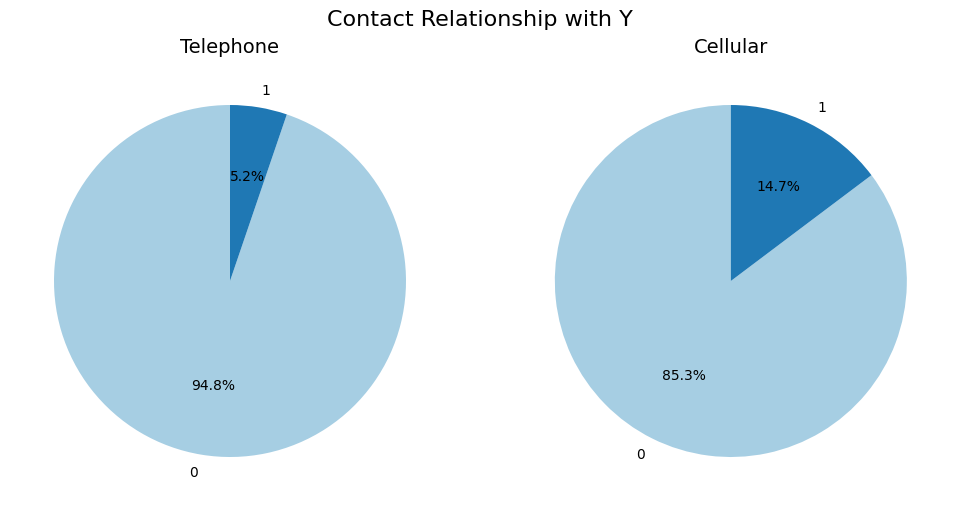

In [194]:
# Bivariate analysis of 'contact' and 'y'

generate_pie_charts_per_category(marketing, 'contact', colors=plt.cm.Paired.colors[:2])


Bivariate Analysis of 'contact' and 'y'



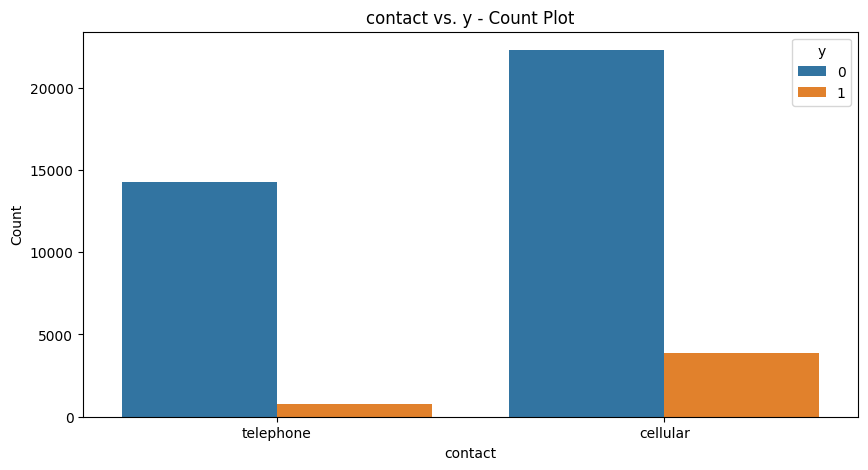

In [233]:
bivariate_analysis(marketing, 'contact', chart_type='bar')

In [234]:
summary_contact = generate_summary_table(marketing, 'contact')

summary_contact

,No_count,Yes_count,No_percent,Yes_percent
contact,,,,
cellular,22289,3851,85.267789,14.732211
telephone,14253,787,94.767287,5.232713


Better to contact them by cellular than telephone definitely.

#### Default

Summary of 'default':
count     41180
unique        3
top          no
freq      32581
Name: default, dtype: object

Unique values in 'default':
['no' 'unknown' 'yes']



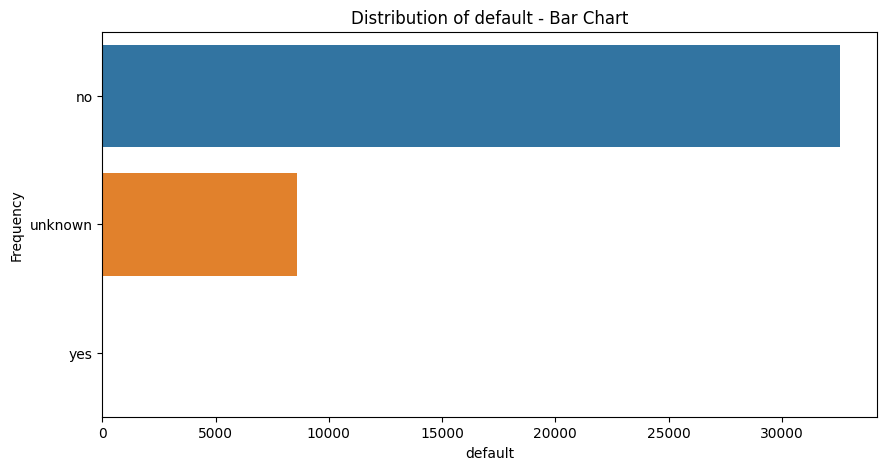

In [195]:
# Analyze the 'default' variable
analyze_column(marketing, 'default', chart_type='bar')


In [240]:
bivariate_analysis(marketing, 'default', chart_type='stacked')

nonlocaldefault_summary = generate_summary_table(marketing, 'default')

# Display the summary table
print(default_summary)


Bivariate Analysis of 'default' and 'y'

         No_count  Yes_count  No_percent  Yes_percent
default                                              
no          28386       4195   87.124398    12.875602
unknown      8153        443   94.846440     5.153560
yes             3          0  100.000000     0.000000


### Previous Outcome result

  0%|          | 0/76 [00:00<?, ?it/s]


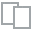
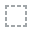
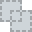
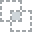
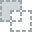
...
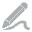
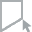
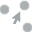
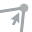
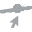

In [197]:
plot(marketing, 'poutcome')

Summary of 'poutcome':
count           41180
unique              3
top       nonexistent
freq            35559
Name: poutcome, dtype: object

Unique values in 'poutcome':
['nonexistent' 'failure' 'success']



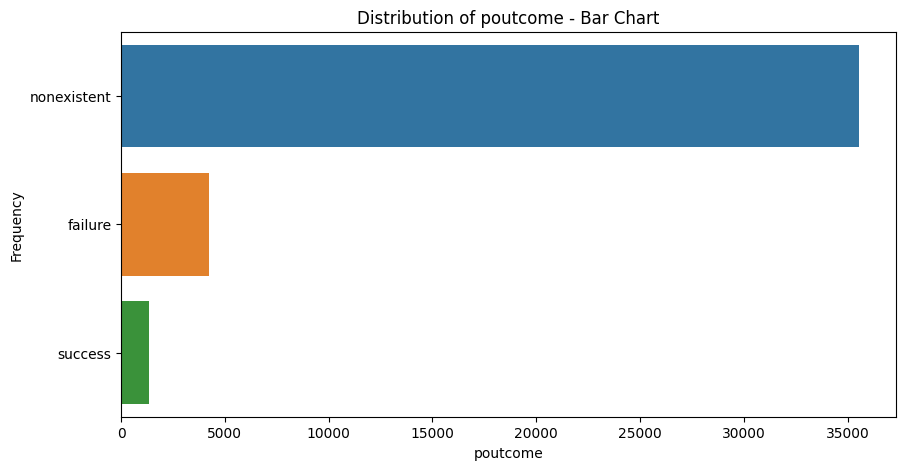

In [198]:
# Analyze the 'poutcome' variable
analyze_column(marketing, 'poutcome', chart_type='bar')


Bivariate Analysis of 'poutcome' and 'y'



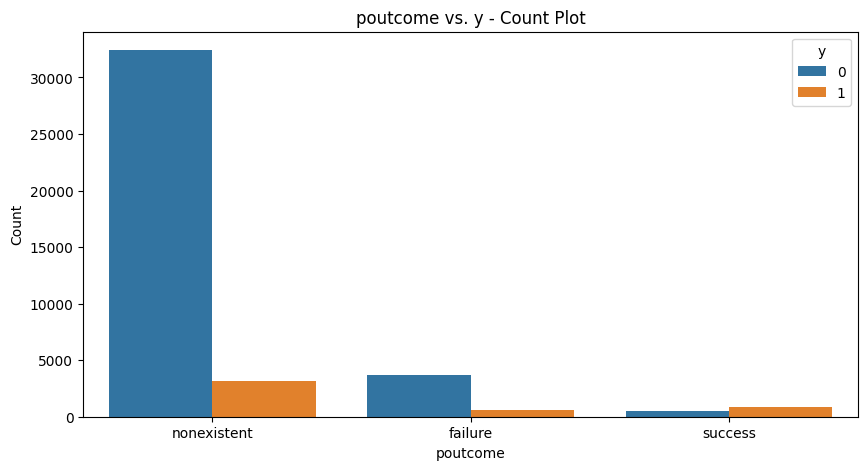

In [199]:
# Bivariate analysis of 'poutcome' and 'y'
bivariate_analysis(marketing, 'poutcome', chart_type='bar')


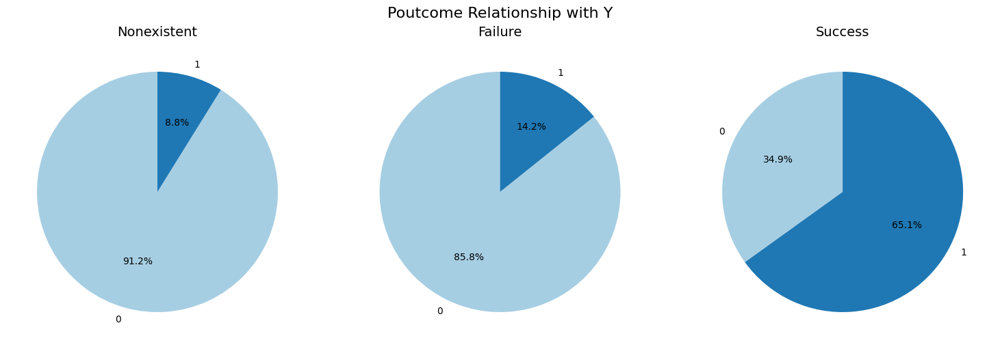

In [231]:
# Bivariate analysis of 'poutcome' and 'y'
generate_pie_charts_per_category(marketing, 'poutcome', colors=plt.cm.Paired.colors[:2])

In [201]:
# Generate summary table for 'poutcome' and 'y'
poutcome_summary = generate_summary_table(marketing, 'poutcome')

# Display the summary table
print(poutcome_summary)

             No_count  Yes_count  No_percent  Yes_percent
poutcome                                                 
success           479        892   34.938001    65.061999
failure          3645        605   85.764706    14.235294
nonexistent     32418       3141   91.166793     8.833207


### Month 

Summary of 'month':
count     41180
unique       10
top         may
freq      13765
Name: month, dtype: object

Unique values in 'month':
['may' 'jun' 'jul' 'aug' 'oct' 'nov' 'dec' 'mar' 'apr' 'sep']



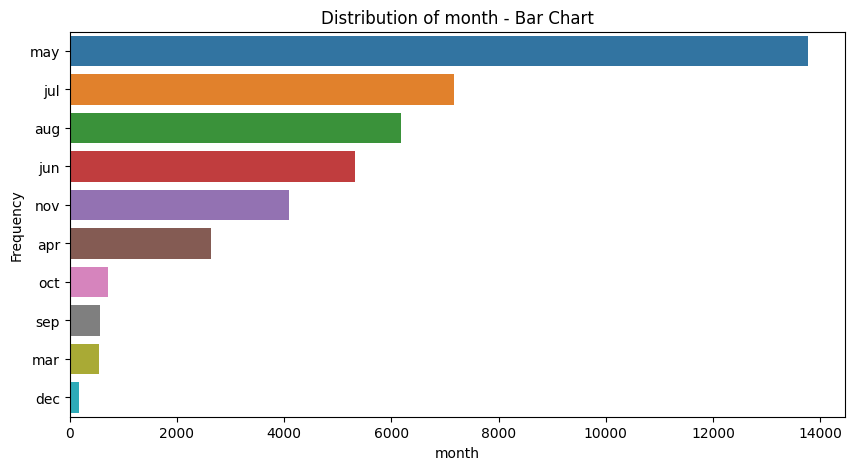

In [48]:
# Analyze the 'month' variable
analyze_column(marketing, 'month', chart_type='bar')


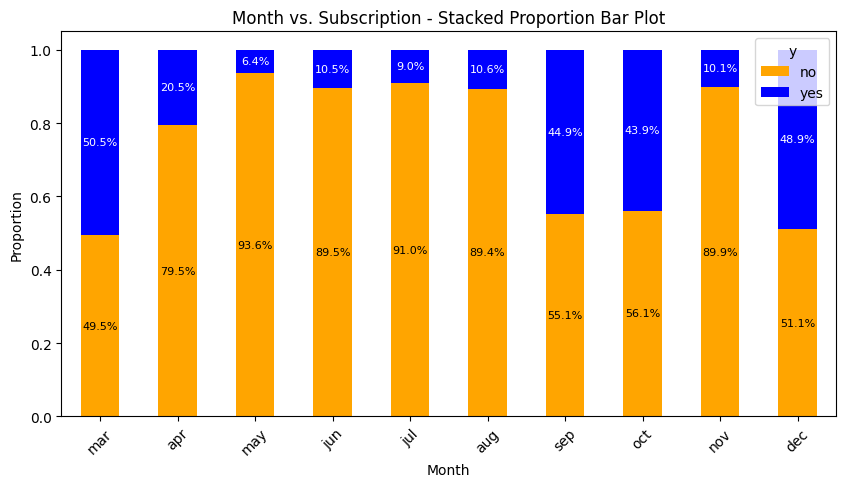

       No_count  Yes_count  No_percent  Yes_percent
month                                              
mar         270        276   49.450549    50.549451
dec          93         89   51.098901    48.901099
sep         314        256   55.087719    44.912281
oct         403        315   56.128134    43.871866
apr        2093        539   79.521277    20.478723
aug        5523        655   89.397863    10.602137
jun        4759        559   89.488530    10.511470
nov        3683        414   89.895045    10.104955
jul        6525        649   90.953443     9.046557
may       12879        886   93.563385     6.436615


In [49]:
import matplotlib.pyplot as plt

month_order = ['mar', 'apr', 'may', 'jun', 'jul', 'aug', 'sep', 'oct', 'nov', 'dec']

# Generate the proportion DataFrame for stacked bar plot
prop_df = (marketing.groupby(['month', 'y']).size() / marketing.groupby(['month']).size()).unstack()

# Order the DataFrame by the specified month order
prop_df = prop_df.loc[month_order]

# Plot the stacked bar plot
ax = prop_df.plot(kind='bar', stacked=True, figsize=(10, 5), color=['orange', 'blue'])
plt.title('Month vs. Subscription - Stacked Proportion Bar Plot')
plt.xlabel('Month')
plt.ylabel('Proportion')
plt.xticks(rotation=45)

# Annotate the bars with the percentages
for i in range(len(prop_df)):
    for j in range(len(prop_df.columns)):
        value = prop_df.iloc[i, j]
        # Set color based on the section of the bar: white for blue ('no') and black for orange ('yes')
        text_color = 'white' if j == 1 else 'black'
        # Display percentages with respective color
        ax.text(i, value / 2 if j == 0 else 1 - (value / 2),
                f'{value * 100:.1f}%', ha='center', va='center', color=text_color, fontsize=8)

plt.show()

# Generate and display the summary table
month_summary = generate_summary_table(marketing, 'month')
print(month_summary)

### Day of Week

Summary of 'day_of_week':
count     41180
unique        5
top         thu
freq       8622
Name: day_of_week, dtype: object

Unique values in 'day_of_week':
['mon' 'tue' 'wed' 'thu' 'fri']



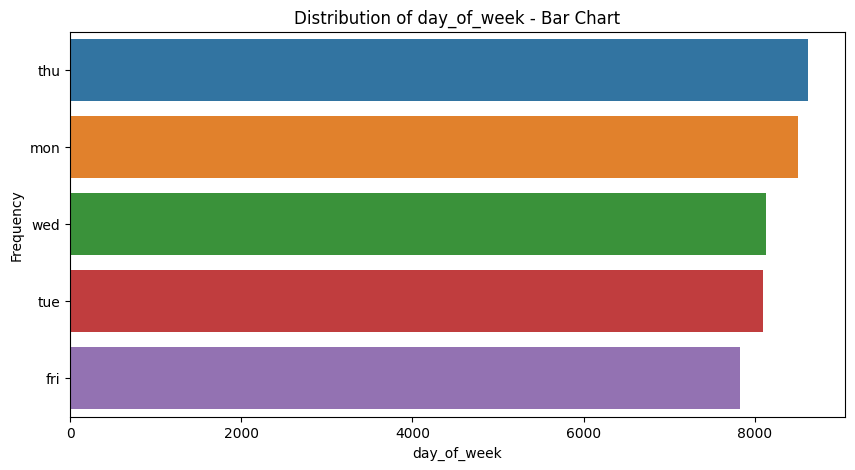

In [50]:
# Analyze the 'day_of_week' variable
analyze_column(marketing, 'day_of_week', chart_type='bar')


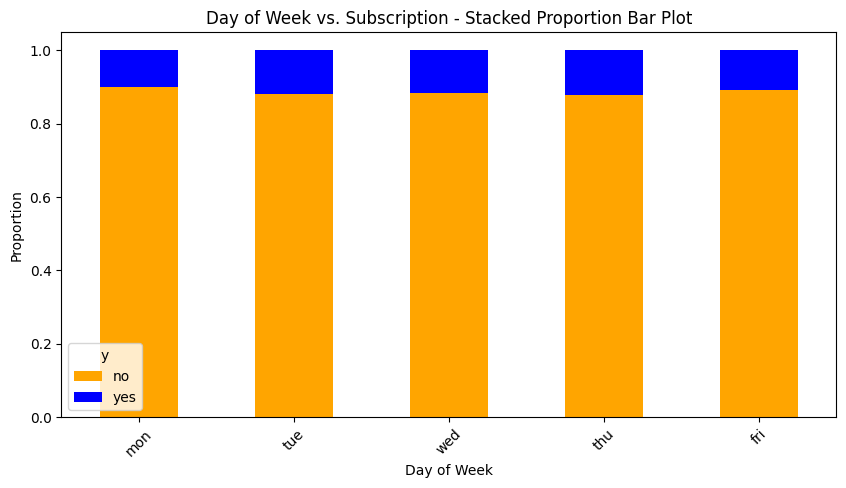

In [51]:

# Define the correct order for the days of the week
day_order = ['mon', 'tue', 'wed', 'thu', 'fri']

# Generate the proportion DataFrame for stacked bar plot
prop_df = (marketing.groupby(['day_of_week', 'y']).size() / marketing.groupby(['day_of_week']).size()).unstack()

# Order the DataFrame by the specified day order
prop_df = prop_df.loc[day_order]

# Plot the stacked bar plot
prop_df.plot(kind='bar', stacked=True, figsize=(10, 5), color=['orange', 'blue'])
plt.title('Day of Week vs. Subscription - Stacked Proportion Bar Plot')
plt.xlabel('Day of Week')
plt.ylabel('Proportion')
plt.xticks(rotation=45)
plt.show()

### Duration

Summary of 'duration':
count    41180.000000
mean       258.280427
std        259.299856
min          0.000000
25%        102.000000
50%        180.000000
75%        319.000000
max       4918.000000
Name: duration, dtype: float64

Unique values in 'duration':
[ 151  307  198 ... 1246 1556 1868]



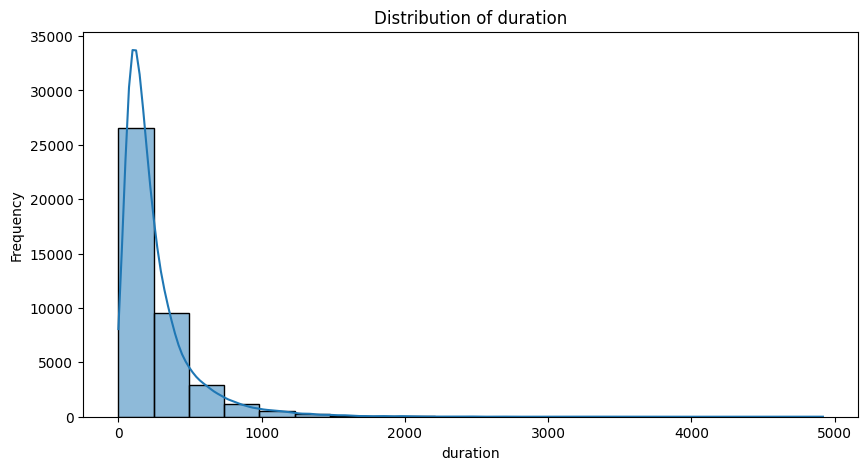

In [52]:
# Analyze the 'duration' variable
analyze_column(marketing, 'duration')


Bivariate Analysis of 'duration' and 'y'



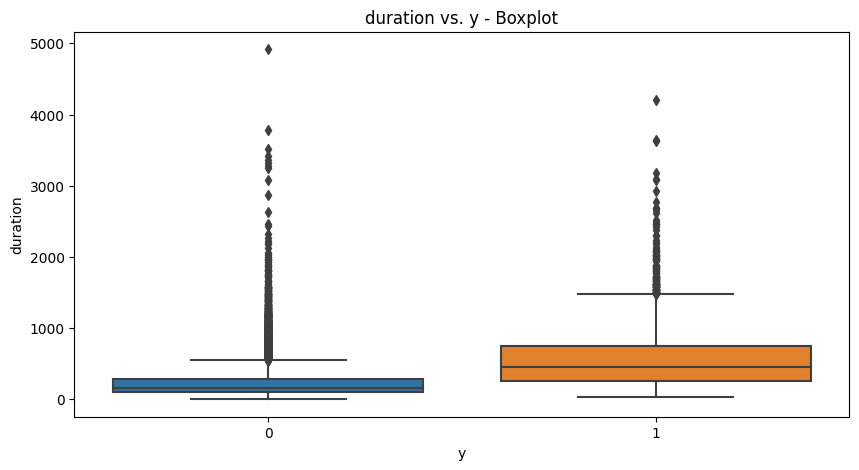

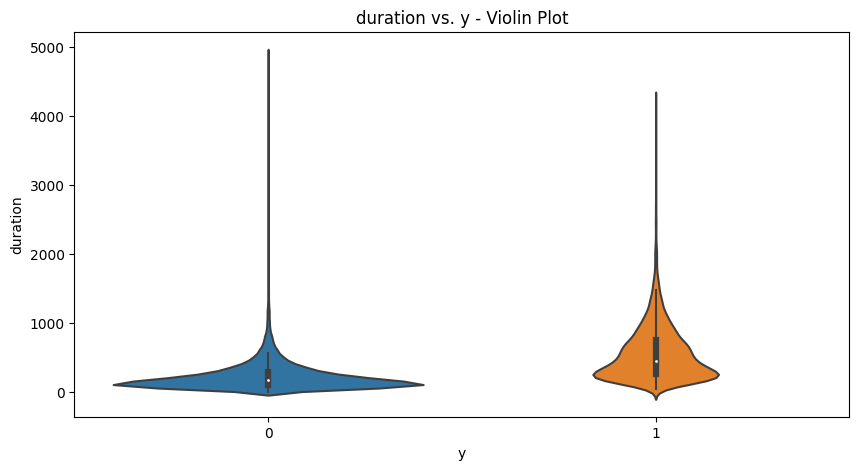

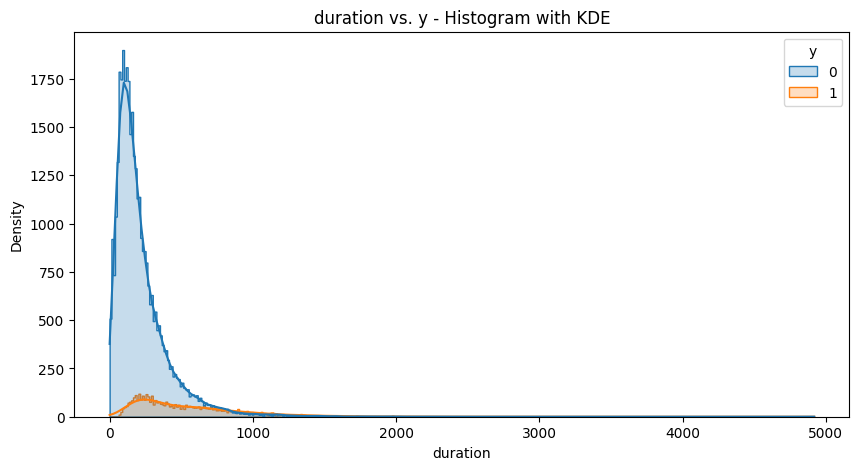

Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


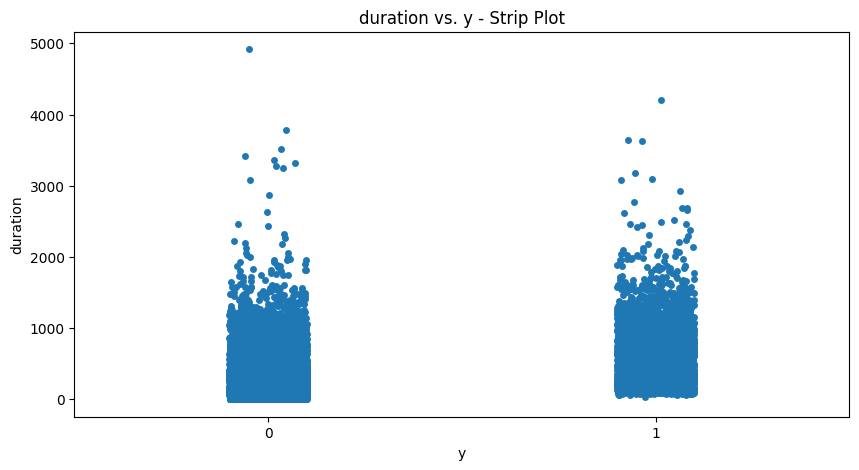

In [203]:
# Bivariate analysis of 'duration' and 'y'
bivariate_analysis(marketing, 'duration')


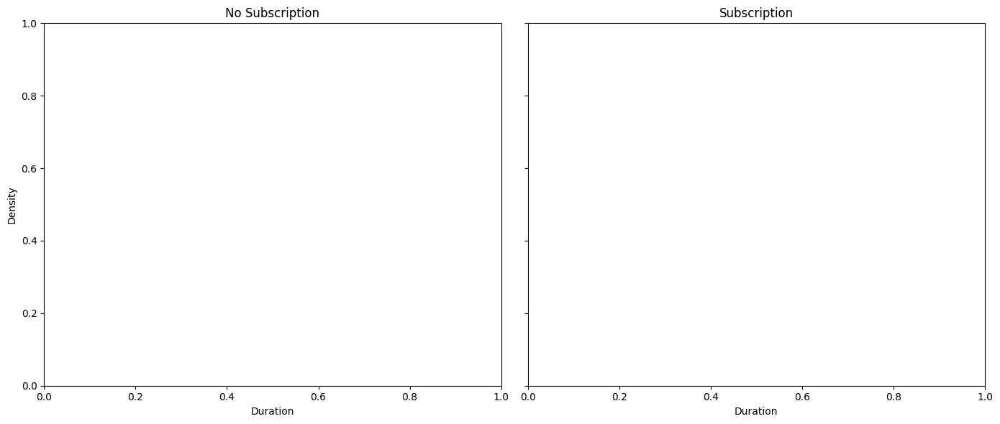

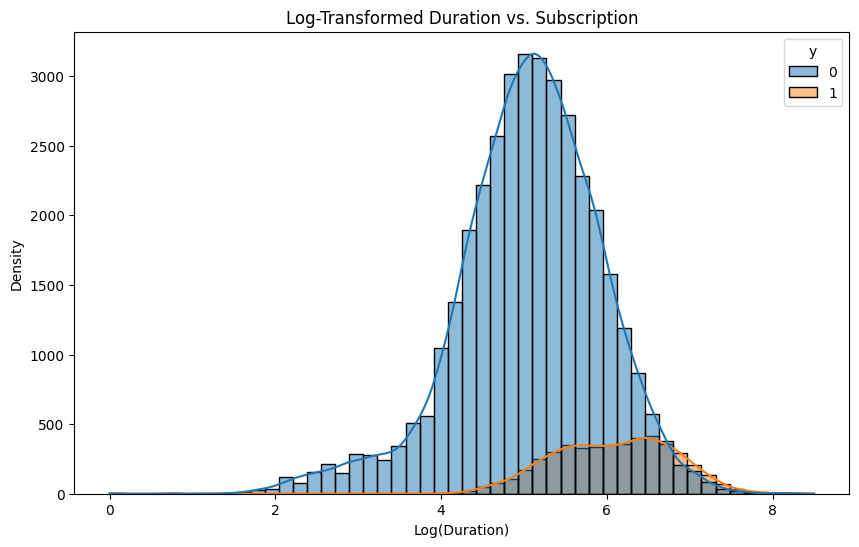

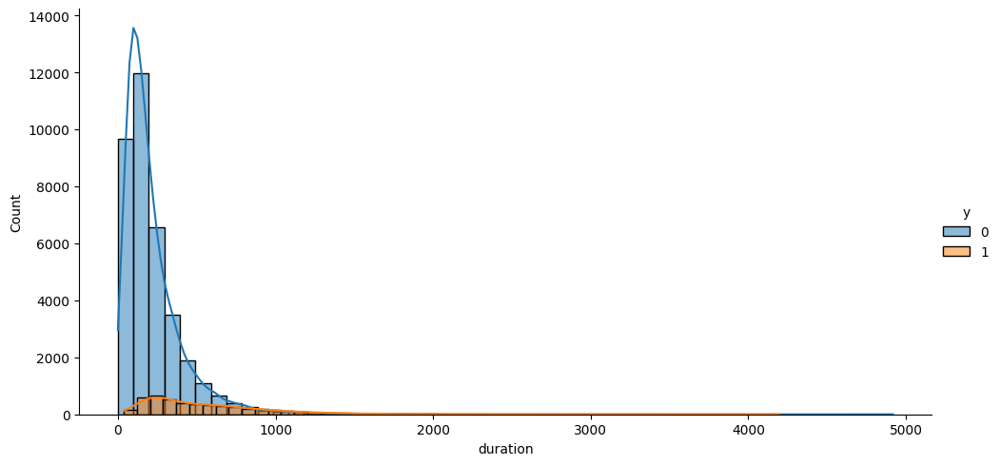

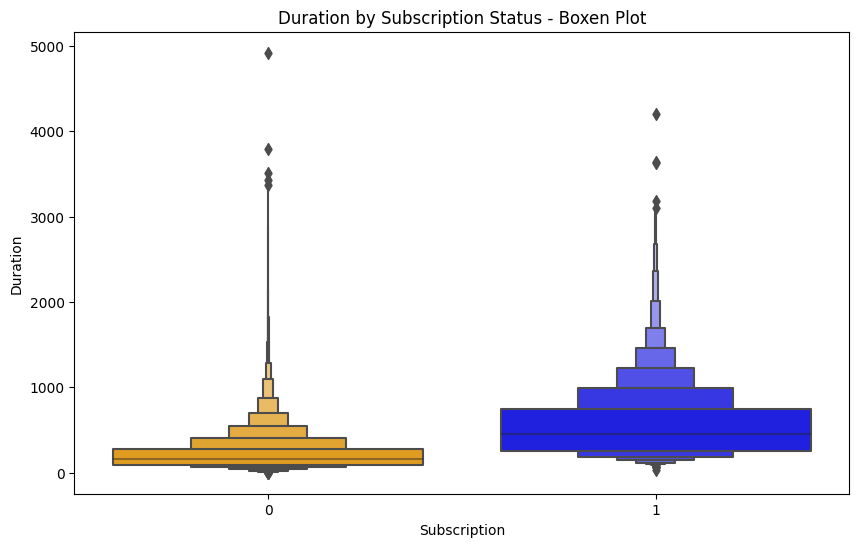

In [204]:

# Option 1: Separate Histograms for Each Group
fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharey=True)
sns.histplot(marketing[marketing['y'] == 'no']['duration'], kde=True, bins=50, ax=axes[0], color='blue')
axes[0].set_title('No Subscription')
axes[0].set_xlabel('Duration')
axes[0].set_ylabel('Density')
sns.histplot(marketing[marketing['y'] == 'yes']['duration'], kde=True, bins=50, ax=axes[1], color='orange')
axes[1].set_title('Subscription')
axes[1].set_xlabel('Duration')
plt.tight_layout()
plt.show()

# Option 2: Log Transformation
marketing['log_duration'] = np.log1p(marketing['duration'])  # Log transformation (log1p to handle zero values)
plt.figure(figsize=(10, 6))
sns.histplot(data=marketing, x='log_duration', hue='y', kde=True, bins=50)
plt.title('Log-Transformed Duration vs. Subscription')
plt.xlabel('Log(Duration)')
plt.ylabel('Density')
plt.show()

# Option 3: Faceted Histogram
g = sns.FacetGrid(marketing, hue='y', aspect=2, height=5)
g.map(sns.histplot, 'duration', bins=50, kde=True)
g.add_legend()
plt.show()

# Option 4: Boxen Plot
plt.figure(figsize=(10, 6))
sns.boxenplot(data=marketing, x='y', y='duration', palette=['orange', 'blue'])
plt.title('Duration by Subscription Status - Boxen Plot')
plt.xlabel('Subscription')
plt.ylabel('Duration')
plt.show()

### Campaign

Summary of 'campaign':
count    41180.000000
mean         2.567800
std          2.770225
min          1.000000
25%          1.000000
50%          2.000000
75%          3.000000
max         56.000000
Name: campaign, dtype: float64

Unique values in 'campaign':
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 19 18 23 14 22 25 16 17 15 20 56
 39 35 42 28 26 27 32 21 24 29 31 30 41 37 40 33 34 43]



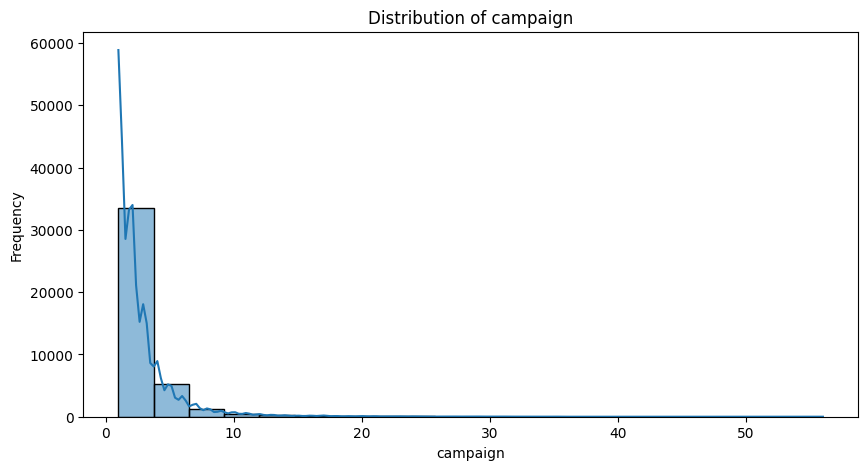

In [55]:
# Analyze the 'campaign' variable
analyze_column(marketing, 'campaign')


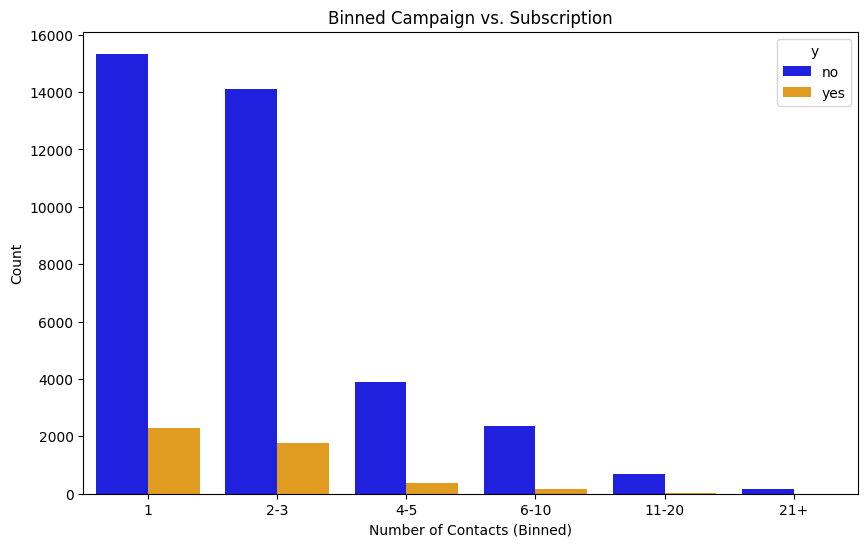

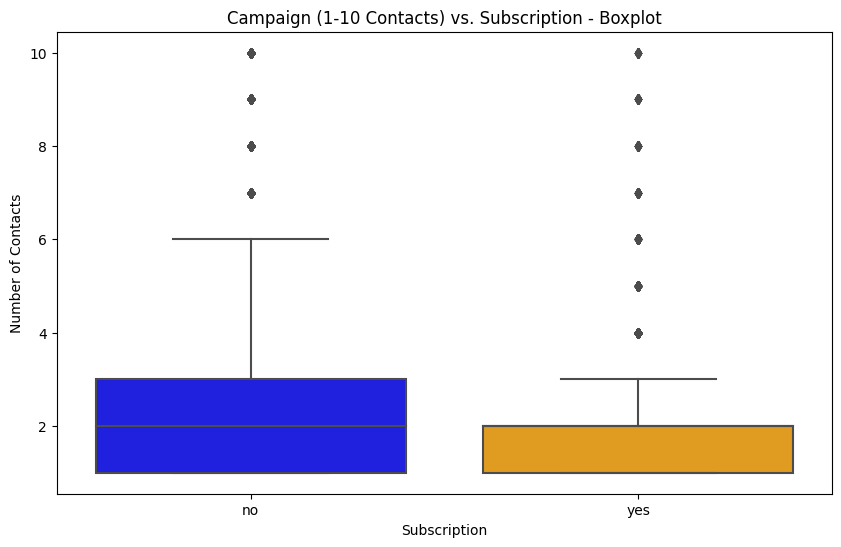

In [56]:

# Option 2: Binning
bins = [0, 1, 3, 5, 10, 20, np.inf]
labels = ['1', '2-3', '4-5', '6-10', '11-20', '21+']
marketing['campaign_binned'] = pd.cut(marketing['campaign'], bins=bins, labels=labels)
plt.figure(figsize=(10, 6))
sns.countplot(x='campaign_binned', hue='y', data=marketing, palette=['blue', 'orange'])
plt.title('Binned Campaign vs. Subscription')
plt.xlabel('Number of Contacts (Binned)')
plt.ylabel('Count')
plt.show()



# Limit the range of 'campaign' to focus on the more typical values (e.g., 1-10 contacts)
plt.figure(figsize=(10, 6))
sns.boxplot(data=marketing[marketing['campaign'] <= 10], x='y', y='campaign', palette=['blue', 'orange'])
plt.title('Campaign (1-10 Contacts) vs. Subscription - Boxplot')
plt.xlabel('Subscription')
plt.ylabel('Number of Contacts')
plt.show()

In [57]:
# Generate summary statistics for the 'campaign' variable for each subscription category
campaign_summary = marketing.groupby('y')['campaign'].describe()

# Display the summary statistics
print(campaign_summary)


       count      mean       std  min  25%  50%  75%   max
y                                                         
no   36542.0  2.633271  2.873621  1.0  1.0  2.0  3.0  56.0
yes   4638.0  2.051962  1.666532  1.0  1.0  2.0  2.0  23.0


#### P-Days

  0%|          | 0/122 [00:00<?, ?it/s]


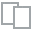
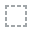
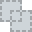
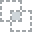
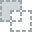
...
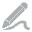
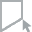
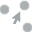
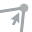
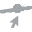

In [58]:
plot(marketing, 'pdays')

Summary of 'pdays':
count    41180.000000
mean       962.516707
std        186.809028
min          0.000000
25%        999.000000
50%        999.000000
75%        999.000000
max        999.000000
Name: pdays, dtype: float64

Unique values in 'pdays':
[999   6   4   3   5   1   0  10   7   8   9  11   2  12  13  14  15  16
  21  17  18  22  25  26  19  27  20]



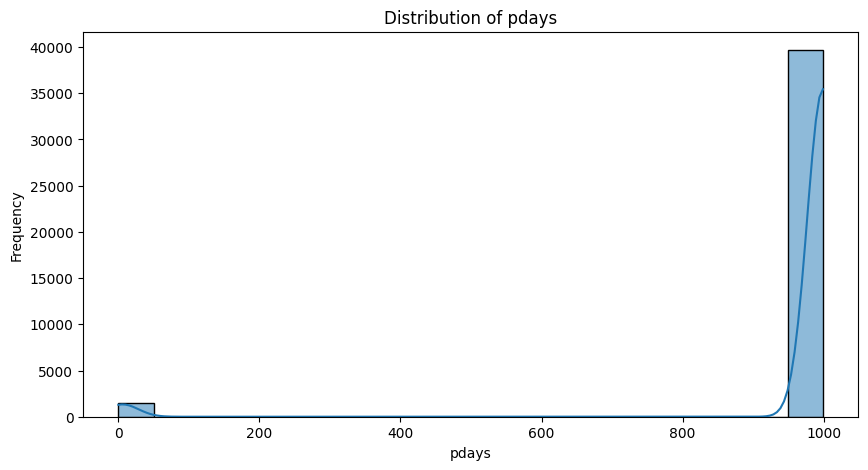

In [59]:
# Analyze the 'campaign' variable
analyze_column(marketing, 'pdays')


In [60]:
# Create a new column for pdays categories
marketing['pdays_category'] = marketing['pdays'].apply(lambda x: 'Not Contacted (-1)' if x == -1 else 'Contacted Previously')

# Display the counts of each category
print(marketing['pdays_category'].value_counts())


Contacted Previously    41180
Name: pdays_category, dtype: int64


In [61]:
original_data['pdays'].unique()

array(['999', '6', '4', '3', '5', '1', '0', '10', '7', '8', '9', '11',
       '2', '12', '13', '14', '15', '16', '21', '17', '18', '22', '25',
       '26', '19', '27', '20'], dtype=object)

The value for 999 seems to be the -1 which explains when there is no call we should analyze it differently

In [62]:
marketing['pdays_category'] = marketing['pdays'].apply(lambda x: 'Not Contacted (999)' if x == 999 else ('Contacted Recently (0)' if x == 0 else 'Contacted Previously'))

# Display the counts of each category
print(marketing['pdays_category'].value_counts())

Not Contacted (999)       39667
Contacted Previously       1498
Contacted Recently (0)       15
Name: pdays_category, dtype: int64


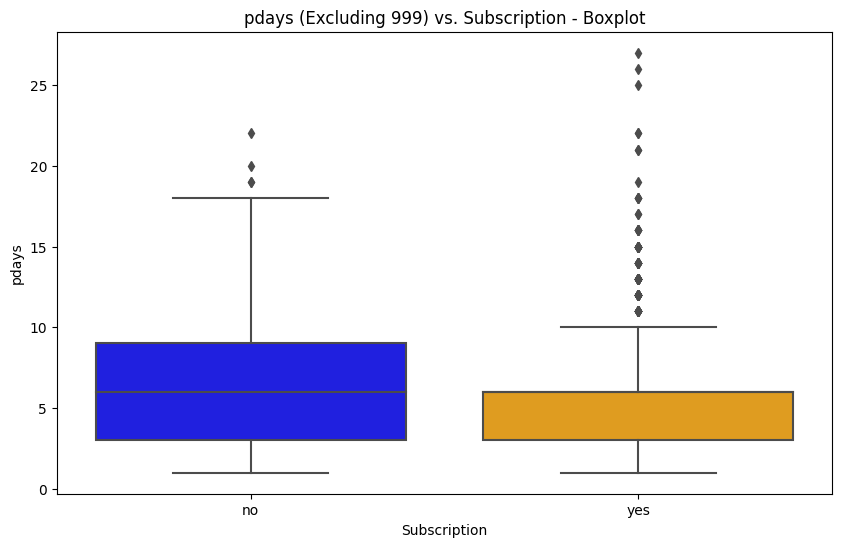

In [63]:
# Filter out 'pdays = 999' and possibly 'pdays = 0'
filtered_pdays = marketing[(marketing['pdays'] > 0) & (marketing['pdays'] < 999)]

# Re-plot the box plot after filtering out 'pdays = 999'
plt.figure(figsize=(10, 6))
sns.boxplot(data=filtered_pdays, x='y', y='pdays', palette=['blue', 'orange'])
plt.title('pdays (Excluding 999) vs. Subscription - Boxplot')
plt.xlabel('Subscription')
plt.ylabel('pdays')
plt.show()


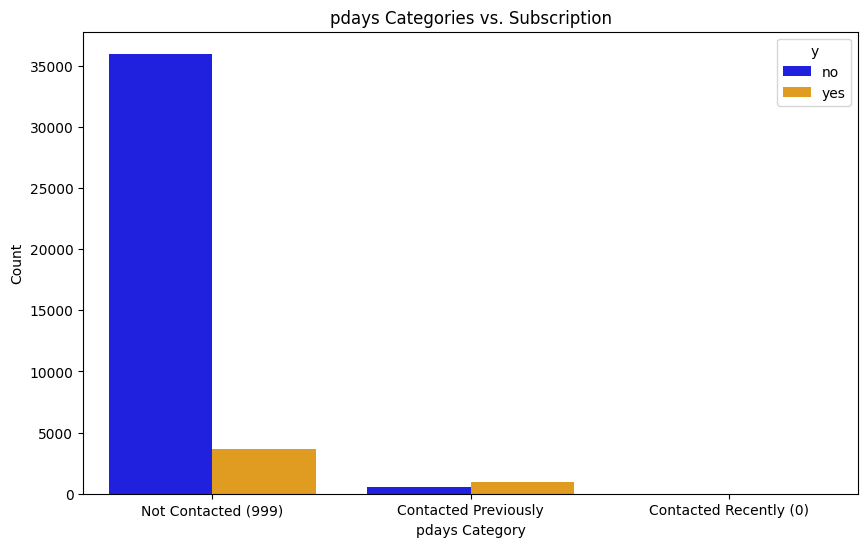

In [64]:
plt.figure(figsize=(10, 6))
sns.countplot(x='pdays_category', hue='y', data=marketing, palette=['blue', 'orange'])
plt.title('pdays Categories vs. Subscription')
plt.xlabel('pdays Category')
plt.ylabel('Count')
plt.show()

In [65]:
# Group the data by 'pdays_category' and 'y', and calculate the count
summary_table = marketing.groupby(['pdays_category', 'y']).size().unstack(fill_value=0)

# Rename the columns for better understanding
summary_table.columns = ['No_count', 'Yes_count']

# Calculate percentages for 'yes' and 'no' in each category
summary_table['No_percent'] = summary_table['No_count'] / (summary_table['No_count'] + summary_table['Yes_count']) * 100
summary_table['Yes_percent'] = summary_table['Yes_count'] / (summary_table['No_count'] + summary_table['Yes_count']) * 100

# Display the summary table
summary_table.reset_index(inplace=True)
summary_table

,pdays_category,No_count,Yes_count,No_percent,Yes_percent
0,Contacted Previously,543,955,36.248331,63.751669
1,Contacted Recently (0),5,10,33.333333,66.666667
2,Not Contacted (999),35994,3673,90.740414,9.259586


### Previous 

  0%|          | 0/75 [00:00<?, ?it/s]


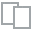
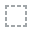
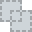
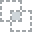
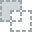
...
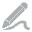
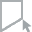
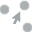
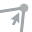
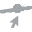

In [66]:
plot(marketing, 'previous')

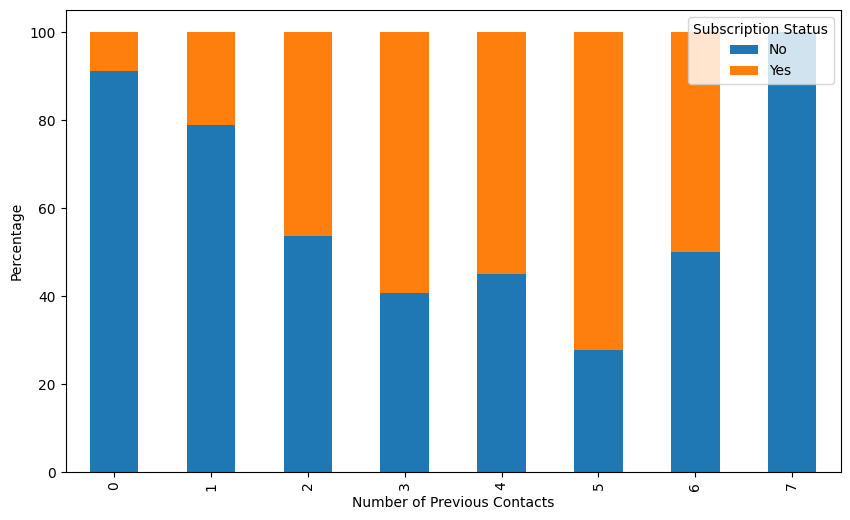

In [209]:
# Group the data by 'previous' and 'y', count the occurrences, and normalize for percentages
grouped_data = marketing.groupby(['previous', 'y']).size().unstack(fill_value=0)

# Calculate percentages
grouped_data_percentage = grouped_data.div(grouped_data.sum(axis=1), axis=0) * 100

# Plot the stacked bar chart with percentages
grouped_data_percentage.plot(kind='bar', stacked=True, figsize=(10, 6), color=['#1f77b4', '#ff7f0e'])
#plt.title('Number of Previous Contacts vs. Subscription Status (Percentage)')
plt.xlabel('Number of Previous Contacts')
plt.ylabel('Percentage')
plt.legend(title='Subscription Status', labels=['No', 'Yes'])
plt.show()

In [68]:
# Group the data by 'previous' and 'y' and calculate counts
previous_summary = marketing.groupby(['previous', 'y']).size().unstack(fill_value=0)

# Rename the columns for better understanding
previous_summary.columns = ['No_count', 'Yes_count']

# Calculate percentages for 'yes' and 'no' in each 'previous' category
previous_summary['No_percent'] = previous_summary['No_count'] / (previous_summary['No_count'] + previous_summary['Yes_count']) * 100
previous_summary['Yes_percent'] = previous_summary['Yes_count'] / (previous_summary['No_count'] + previous_summary['Yes_count']) * 100

# Reset the index to make it a clean table
previous_summary.reset_index(inplace=True)

# Display the summary table
previous_summary

,previous,No_count,Yes_count,No_percent,Yes_percent
0,0,32418,3141,91.166793,8.833207
1,1,3593,966,78.811143,21.188857
2,2,404,350,53.580902,46.419098
3,3,88,128,40.740741,59.259259
4,4,31,38,44.927536,55.072464
5,5,5,13,27.777778,72.222222
6,6,2,2,50.000000,50.000000
7,7,1,0,100.000000,0.000000
